<img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 20px; height: 55px">

# Predicting Music Decades with `spotipy`


---

### Problem

- Has the sonic landscape of music changed over time?

- If so, we should be able to predict a song's decade from its auditory features
- We can use `spotipy`, Spotify's Python package for working with the Spotify API, to extract features


### Workflow

We'll be navigating the Spotify API using their Python package `spotipy` to get features on songs. After cleaning the data and getting rid of duplicates, we'll optimise a model to predict when a song was released (within a decade) based solely off auditory features. In the process, we'll discover a great deal about the progression of music over the last few decades.

<h1>Project navigator<span class="tocSkip"></span></h1>
    <div class="toc"><ul class="toc-item"><li><span><a href="#Introducing-Spotipy" data-toc-modified-id="Introducing-Spotipy">Introducing Spotipy</a></span>
        <ul class="toc-item"><li><span><a href="#Accessing-the-Spotify-Web-API-through-spotipy" data-toc-modified-id="Accessing-the-Spotify-Web-API-through-spotipy">Accessing the Spotify Web API through spotipy</a></span></li>
        <li><span><a href="#Getting-songs" data-toc-modified-id="Getting-songs">Getting songs</a></span></li>
        <li><span><a href="#Getting-albums" data-toc-modified-id="Getting-albums">Getting albums</a></span></li>
        <li><span><a href="#Spotify-audio-analysis" data-toc-modified-id="Spotify-audio-analysis">Spotify audio analysis</a></span></li></ul></li>
<li><span><a href="#Extracting-data-and-testing-the-validity-of-a-model" data-toc-modified-id="Extracting-data-and-testing-the-validity-of-a-model">Extracting data and testing the validity of a model</a></span>
        <ul class="toc-item"><li><span><a href="#Munging-data-into-a-format-suitable-for-modelling" data-toc-modified-id="Munging-data-into-a-format-suitable-for-modelling">Munging data into a format suitable for modelling</a></span></li>
        <li><span><a href="#Creating-a-target" data-toc-modified-id="Creating-a-target">Creating a target</a></span></li></ul></li>
<li><span><a href="#Extracting-and-cleaning-the-data" data-toc-modified-id="Extracting-and-cleaning-the-data">Extracting and cleaning the data</a></span>
        <ul class="toc-item"><li><span><a href="#Automating-the-process" data-toc-modified-id="Automating-the-process">Automating the process</a></span></li></ul></li>
<li><span><a href="#Creating-a-data-dictionary" data-toc-modified-id="Creating-a-data-dictionary">Creating a data dictionary</a></span></li>
<li><span><a href="#Addressing-the-sampling-bias" data-toc-modified-id="Addressing-the-sampling-bias">Addressing the sampling bias</a></span></li>
<li><span><a href="#Duplicates" data-toc-modified-id="Duplicates">Duplicates</a></span></li>
<li><span><a href="#Remasters" data-toc-modified-id="Remasters">Remasters</a></span></li>
<li><span><a href="#Compilations" data-toc-modified-id="Compilations">Compilations</a></span></li>   
<li><span><a href="#EDA-and-Visualisation" data-toc-modified-id="EDA-and-Visualisation">EDA and Visualisation</a></span></li>   
<li><span><a href="#Timeseries-analysis" data-toc-modified-id="Timeseries-analysis">Timeseries analysis</a></span></li>
    <ul class="toc-item"><li><span><a href="#Loudness-trends" data-toc-modified-id="Loudness-trends">Loudness trends</a></span></li></ul>
    <ul class="toc-item"><li><span><a href="#Acousticness" data-toc-modified-id="Acousticness">Acousticness</a></span></li></ul>
<li><span><a href="#Librosa" data-toc-modified-id="Librosa">Librosa</a></span></li>
    <ul class="toc-item"><li><span><a href="#Spectrograms-with-Librosa" data-toc-modified-id="Spectrograms-with-Librosa">Spectrograms with Librosa</a></span></li></ul> 
<li><span><a href="#Modelling" data-toc-modified-id="Modelling">Modelling</a></span></li>
<ul class="toc-item"><li><span><a href="#Bagging" data-toc-modified-id="Bagging">Bagging</a></span></li></ul> 
<ul class="toc-item"><li><span><a href="#Oversampling-with-SMOTE-NC" data-toc-modified-id="Oversampling-with-SMOTE-NC">Oversampling with SMOTE NC</a></span></li></ul>
<ul class="toc-item"><li><span><a href="#Random-Forest-without-oversampling" data-toc-modified-id="Random-Forest-without-oversampling">Random Forest without oversampling</a></span></li></ul>
<ul class="toc-item"><li><span><a href="#Evaluating-the-model" data-toc-modified-id="Evaluating-the-model">Evaluating the model</a></span></li></ul>
<ul class="toc-item"><li><span><a href="#Feature-importance" data-toc-modified-id="Feature-importance">Feature importance</a></span></li></ul>
<ul class="toc-item"><li><span><a href="#Decision-tree-plot" data-toc-modified-id="Decision-tree-plot">Decision tree plot</a></span></li></ul>
<li><span><a href="#Workarounds" data-toc-modified-id="Workarounds">Workarounds</a></span></li>
<ul class="toc-item"><li><span><a href="#Binarizing-the-model" data-toc-modified-id="Binarizing-the-model">Binarizing the model</a></span></li></ul>
<ul class="toc-item"><li><span><a href="#Distinguishing-the-data" data-toc-modified-id="Distinguishing-the-data">Distinguishing the data</a></span></li></ul>
<ul class="toc-item"><li><span><a href="#Linear-regression-on-loudness" data-toc-modified-id="Linear-regression-on-loudness">Linear regression on loudness</a></span></li></ul>
<li><span><a href="#Conclusions" data-toc-modified-id="Conclusions">Conclusions</a></span></li>

In [1]:
import requests

from bs4 import BeautifulSoup
from tqdm import tqdm_notebook
from pprint import pprint
import numpy as np
import re
import patsy
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import statsmodels.formula.api as sm
from statsmodels.tsa.arima_model import ARIMA
import warnings

import os
import sys
import json
import spotipy
import webbrowser
import spotipy.util as util
from json.decoder import JSONDecodeError
from mpl_toolkits.mplot3d import Axes3D
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline
from sklearn.neighbors import KNeighborsClassifier
from sklearn import datasets, metrics
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV, ElasticNet
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.feature_extraction.text import HashingVectorizer, TfidfVectorizer, CountVectorizer
from sklearn.naive_bayes import MultinomialNB, BernoulliNB, GaussianNB
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score, confusion_matrix, classification_report
from sklearn.decomposition import PCA
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler, SMOTE, SMOTENC
from imblearn.pipeline import make_pipeline as make_pipeline_imb
from sklearn.ensemble import BaggingClassifier, AdaBoostClassifier, AdaBoostRegressor, \
GradientBoostingClassifier, GradientBoostingRegressor, RandomForestClassifier
from sklearn import svm
from sklearn.tree import export_graphviz
from IPython import display

from joblib import dump, load

from matplotlib.colors import ListedColormap
cmap = ListedColormap(sns.color_palette(sns.diverging_palette(130, 260, center='light'),3))
import datetime
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import bokeh
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

from scipy.sparse import coo_matrix, hstack
from scipy import stats
from scipy import signal

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

sns.set(font_scale=1.5)



warnings.simplefilter('ignore')
pd.options.display.max_columns = 100

/anaconda3/envs/backup/lib/python3.7/site-packages/dask/config.py:168: YAMLLoadWarning:

calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.



## Introducing Spotipy

`spotipy` is a lightweight Python library for the Spotify Web API. We will be using it to extract features from various songs and build a dataset.

<a id='Spotipy-Access'></a>
### Accessing the Spotify Web API through `spotipy`

In [2]:
# get username
username = sys.argv[1]

# Make API call
URL = 'https://accounts.spotify.com/authorize'
params = {'client_id': '5cf34aa394ce41348e14e191abcbcabf', 'redirect_uri': 'https://google.com/'}
r_ = requests.get(URL, params=params)


soup = BeautifulSoup(r_.text, 'html.parser')

### Getting songs

Spotify API uses a system of Uniform Resource Identifiers (URIs; essentially IDs) to uniquely catalogue all of Spotify's objects. We call various search functions to get the required URI for an artist, then use pass that to another function to get their album, then the songs in that album.

In [3]:
from spotipy.oauth2 import SpotifyClientCredentials #To access authorised Spotify data

client_id = '5cf34aa394ce41348e14e191abcbcabf'
client_secret = '0614e00064074071a42582fc6acda813'
client_credentials_manager = SpotifyClientCredentials(client_id=client_id, client_secret=client_secret)
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager) #spotify object to access API
name = "Serge Gainsbourg" #chosen artist
result = sp.search(name) #search query
result['tracks']['items'][0]['artists']

[{'external_urls': {'spotify': 'https://open.spotify.com/artist/1q24xIsAD7JZuVkTLR9TJy'},
  'href': 'https://api.spotify.com/v1/artists/1q24xIsAD7JZuVkTLR9TJy',
  'id': '1q24xIsAD7JZuVkTLR9TJy',
  'name': 'Brigitte Bardot',
  'type': 'artist',
  'uri': 'spotify:artist:1q24xIsAD7JZuVkTLR9TJy'},
 {'external_urls': {'spotify': 'https://open.spotify.com/artist/01C9OoXDvCKkGcf735Tcfo'},
  'href': 'https://api.spotify.com/v1/artists/01C9OoXDvCKkGcf735Tcfo',
  'id': '01C9OoXDvCKkGcf735Tcfo',
  'name': 'Serge Gainsbourg',
  'type': 'artist',
  'uri': 'spotify:artist:01C9OoXDvCKkGcf735Tcfo'}]

### Getting albums

In [10]:
#Extract Artist's uri
artist_uri = result['tracks']['items'][0]['artists'][1]['uri']
#Pull all of the artist's albums
sp_albums = sp.artist_albums(artist_uri, album_type='album')
#Store artist's albums' names' and uris in separate lists
album_names = []
album_uris = []
for i in range(len(sp_albums['items'])):
    album_names.append(sp_albums['items'][i]['name'])
    album_uris.append(sp_albums['items'][i]['uri'])
    
list(zip(album_names, album_uris))[:5]
#Keep names and uris in same order to keep track of duplicate albums

[('Premiers Tubes', 'spotify:album:6r9oiiIooEOuQ3B8ubxMp0'),
 ('Anthologie de la chanson française',
  'spotify:album:0PjWe8vmOO44KzmmIZpJuz'),
 ('Cannabis / Ce Sacré Grand-Père (DSDリマスタリング)',
  'spotify:album:6YLZT3Jz5XXruv6o37lJH2'),
 ('Le Cinema de Serge Gainsbourg (DSDリマスタリング)',
  'spotify:album:2fciHLC5UQOZnGUQHw4smE'),
 ('Gainsbourg & The Revolutionaries', 'spotify:album:5ZuJi7rWwGOHpXyJQi0gle')]

In [161]:
pprint(sp.album_tracks(album_uris[0])['items'])

# Has info for each track, including featured artists, durations and available markets

[{'artists': [{'external_urls': {'spotify': 'https://open.spotify.com/artist/01C9OoXDvCKkGcf735Tcfo'},
               'href': 'https://api.spotify.com/v1/artists/01C9OoXDvCKkGcf735Tcfo',
               'id': '01C9OoXDvCKkGcf735Tcfo',
               'name': 'Serge Gainsbourg',
               'type': 'artist',
               'uri': 'spotify:artist:01C9OoXDvCKkGcf735Tcfo'}],
  'available_markets': ['AD',
                        'AE',
                        'AR',
                        'AT',
                        'AU',
                        'BE',
                        'BG',
                        'BH',
                        'BO',
                        'BR',
                        'CA',
                        'CH',
                        'CL',
                        'CO',
                        'CR',
                        'CY',
                        'CZ',
                        'DE',
                        'DK',
                        'DO',
                        '

In [162]:
# Let's try extracting just the names for one album, Gainsbourg's 'Premiers Tubes'

trax = []
for song in sp.album_tracks(album_uris[0])['items']:
    try: 
        trax.append(song['name'])
    except:
        trax.append(np.nan)

In [163]:
trax

['Douze belles dans la peau',
 'La bataille de Friedland',
 'Le poinçonneur des lilas',
 'La recette de l’amour fou',
 'La chanson de Maglia',
 'Les amours perdues',
 'Serge Gainsbourg répond à Juliette Gréco',
 'Le chachacha des chauves M. Arnaud',
 'Valse op.69 n°1 (reprise de Chopin)',
 'J’ai mal à la tête (reprise de Georges Ulmer)',
 'Les goémons',
 'L’eau à la bouche']

In [165]:
# Now the IDs for the same tracks (essentially the URI but without info on the object type like 'spotify:album:')

ids = []
for song in sp.album_tracks(album_uris[0])['items']:
    try: 
        ids.append(song['id'])
    except:
        ids.append(np.nan)

### Spotify audio analysis

This will form our feature set, on which we will model. The low-level analysis is based on Principal Component Analysis of the original signal from the tracks, and is underdocumented (presumably to prevent copywright infringement). However, we can use the higher-level features drawn from it to construct our dataframe.

In [166]:
# A low-level analysis of a track, with info on the structure and musical content of the
# audio sample on a millisecond by millisecond basis

sp.audio_analysis(ids[0])

{'meta': {'analyzer_version': '4.0.0',
  'platform': 'Linux',
  'detailed_status': 'OK',
  'status_code': 0,
  'timestamp': 1556398968,
  'analysis_time': 3.02763,
  'input_process': 'libvorbisfile L+R 44100->22050'},
 'track': {'num_samples': 2496942,
  'duration': 113.24,
  'sample_md5': '',
  'offset_seconds': 0,
  'window_seconds': 0,
  'analysis_sample_rate': 22050,
  'analysis_channels': 1,
  'end_of_fade_in': 2.85605,
  'start_of_fade_out': 113.24,
  'loudness': -18.901,
  'tempo': 69.433,
  'tempo_confidence': 0.0,
  'time_signature': 4,
  'time_signature_confidence': 0.975,
  'key': 11,
  'key_confidence': 0.25,
  'mode': 0,
  'mode_confidence': 0.427,
  'codestring': 'eJxVmV3WHSsIRKfiEPxH5j-xuzd9clfyknx22ypQFIVn3Dli7zdab6efE7P300bk5J-5bx_vtjmDYZ7Z1zm7zXN7W3lOX_F6m3F4u3O-3SeT335t33XHXRFtzbtbjBcz1uCzPXfLOXevlRffNF_eE6vxsLd9cuY-cdoe87XROd3qczLmrxans994s_GYf8adcSefvbztHuZxkoUtj1OcvuP2GO3s_tocvMUWLD3LvTnHS_Y9j8mn37fnGrvdvp38Tr7g28th257Z3-gn272uPDH3XhYN7fuGryfH4yxjcWieM-Rhw4zOhica7

In [167]:
# Spotify's in-house analysis of the above values at an overall level
# - we will be using these for initial modelling

sp.audio_features(ids[0])

[{'danceability': 0.596,
  'energy': 0.24,
  'key': 11,
  'loudness': -18.901,
  'mode': 0,
  'speechiness': 0.834,
  'acousticness': 0.964,
  'instrumentalness': 0.00121,
  'liveness': 0.927,
  'valence': 0.948,
  'tempo': 69.433,
  'type': 'audio_features',
  'id': '5yMuDSIAhkBijayDrauA8G',
  'uri': 'spotify:track:5yMuDSIAhkBijayDrauA8G',
  'track_href': 'https://api.spotify.com/v1/tracks/5yMuDSIAhkBijayDrauA8G',
  'analysis_url': 'https://api.spotify.com/v1/audio-analysis/5yMuDSIAhkBijayDrauA8G',
  'duration_ms': 113240,
  'time_signature': 4}]

In [125]:
# An artist ID
sp.search('Calvin Harris', type='artist')['artists']['items'][0]['id']

'7CajNmpbOovFoOoasH2HaY'

In [126]:
# The artist URI (both work for querying the artist)
sp.search(artist)['tracks']['items'][0]['artists'][0]['uri']

'spotify:artist:7CajNmpbOovFoOoasH2HaY'

## Extracting data and testing the validity of a model

The next section is concerned with getting the works of 4 artists and modelling them as a proof of concept.

In [179]:
# Now to extract all the necessary features for an artist with a nested list comprehension
# N.B. The artist URI has been assigned to a variable and then called because Spotify doesn't allow double
# querying of the sort sp.artist_albums(sp.search('Calvin Harris')...

artist = 'Rihanna'
artist_uri = sp.search(artist)['tracks']['items'][0]['artists'][0]['uri']

songs = [[artist, item['name'], item['uri'], song['name'],
  item['release_date']] + list(sp.audio_features(song['uri'])[0].values()) 
 for item in sp.artist_albums(
     artist_uri,
                              album_type='album', limit=None)['items'] 
 for song in sp.album_tracks(item['uri'])['items']]

In [180]:
songs[0]

['Rihanna',
 'Black Panther The Album Music From And Inspired By',
 'spotify:album:3pLdWdkj83EYfDN6H2N8MR',
 'Black Panther',
 '2018-02-09',
 0.618,
 0.582,
 1,
 -9.454,
 1,
 0.297,
 0.625,
 3.84e-06,
 0.265,
 0.48,
 90.035,
 'audio_features',
 '5qN4HFkapdAOV94XPryVof',
 'spotify:track:5qN4HFkapdAOV94XPryVof',
 'https://api.spotify.com/v1/tracks/5qN4HFkapdAOV94XPryVof',
 'https://api.spotify.com/v1/audio-analysis/5qN4HFkapdAOV94XPryVof',
 130613,
 4]

In [199]:
# Good, that worked. Now let's try with several artists (with tqdm to keep track of each album)

artists = ['Calvin Harris', 'Rihanna', 'The Beach Boys', 'The Beatles']

tracks = []

for artist in artists:
    
    artist_uri = sp.search(artist)['tracks']['items'][0]['artists'][0]['uri']
    
    for album in tqdm_notebook(sp.artist_albums(artist_uri, album_type='album', limit=None)['items']):
        
        tracks.extend([[artist, album['name'], album['uri'], song['name'],
                        
          album['release_date']] + list(sp.audio_features(song['uri'])[0].values()) 
                       for song in sp.album_tracks(album['uri'])['items']])

retrying ...1secs



retrying ...1secs
retrying ...1secs



retrying ...1secs



### Munging data into a format suitable for modelling

In [228]:
# put the works of the 4 artists into a dataframe

df = pd.DataFrame(tracks, columns=['artist',
 'album_name',
 'album_uri',
 'track',
 'release_date'] + list(sp.audio_features('7tr2za8SQg2CI8EDgrdtNl')[0].keys()))

df.rename(columns={'uri':'song_uri'}, inplace=True)

df.drop_duplicates(subset=['artist', 'track'], inplace=True)

df.shape

(1227, 23)

In [26]:
# reorder the cols to have identifiers first, predictors last
cols = ['artist',
 'album_name',
 'album_uri',
 'track',
 'release_date',
 'id',
 'song_uri',
 'track_href',
 'analysis_url',
 'type',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'duration_ms',
 'time_signature']

df = df[cols]

In [225]:
df.head()

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,type,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Calvin Harris,Funk Wav Bounces Vol.1,spotify:album:2HaqChIDc5go3qxVunBDK0,Slide (feat. Frank Ocean & Migos),2017-06-30,7tr2za8SQg2CI8EDgrdtNl,spotify:track:7tr2za8SQg2CI8EDgrdtNl,https://api.spotify.com/v1/tracks/7tr2za8SQg2C...,https://api.spotify.com/v1/audio-analysis/7tr2...,audio_features,0.736,0.795,1,-3.299,0,0.0545,0.498,0.000001,0.2540,0.511,104.066,230813,4
1,Calvin Harris,Funk Wav Bounces Vol.1,spotify:album:2HaqChIDc5go3qxVunBDK0,"Cash Out (feat. ScHoolboy Q, PARTYNEXTDOOR & D...",2017-06-30,0Ws8D3EWUDgY962Xftb0h5,spotify:track:0Ws8D3EWUDgY962Xftb0h5,https://api.spotify.com/v1/tracks/0Ws8D3EWUDgY...,https://api.spotify.com/v1/audio-analysis/0Ws8...,audio_features,0.722,0.790,4,-4.867,0,0.2410,0.152,0.000000,0.0349,0.434,94.965,235973,4
2,Calvin Harris,Funk Wav Bounces Vol.1,spotify:album:2HaqChIDc5go3qxVunBDK0,"Heatstroke (feat. Young Thug, Pharrell William...",2017-06-30,60APt5N2NRaKWf5xzJdzyC,spotify:track:60APt5N2NRaKWf5xzJdzyC,https://api.spotify.com/v1/tracks/60APt5N2NRaK...,https://api.spotify.com/v1/audio-analysis/60AP...,audio_features,0.784,0.728,0,-4.549,0,0.0539,0.340,0.000000,0.2220,0.713,110.165,229160,4
3,Calvin Harris,Funk Wav Bounces Vol.1,spotify:album:2HaqChIDc5go3qxVunBDK0,Rollin (feat. Future & Khalid),2017-06-30,0lMbuWUpfTWhEmOKxppEau,spotify:track:0lMbuWUpfTWhEmOKxppEau,https://api.spotify.com/v1/tracks/0lMbuWUpfTWh...,https://api.spotify.com/v1/audio-analysis/0lMb...,audio_features,0.753,0.760,6,-4.518,0,0.0859,0.446,0.000031,0.1820,0.657,91.953,272653,4
4,Calvin Harris,Funk Wav Bounces Vol.1,spotify:album:2HaqChIDc5go3qxVunBDK0,Prayers Up (feat. Travis Scott & A-Trak),2017-06-30,4KaIJ1FWXUoAAnOts1YWjD,spotify:track:4KaIJ1FWXUoAAnOts1YWjD,https://api.spotify.com/v1/tracks/4KaIJ1FWXUoA...,https://api.spotify.com/v1/audio-analysis/4KaI...,audio_features,0.821,0.637,9,-4.276,0,0.1610,0.433,0.000000,0.2090,0.778,86.010,204280,4


### Creating a target

In [12]:
# Make target from getting the beginning of the release date

df['decade_start'] = df.release_date.apply(lambda x: int(x[:3]+'0'))

In [217]:
# extract predictors/target
predictors = df.iloc[:, 10:].copy()
y = predictors.pop('decade_start')

In [223]:
# train-test split, Gaussian Naive Bayes model to check the viability of the model
X_train, X_test, y_train, y_test = train_test_split(predictors, y)

gnb = GaussianNB()

gnb.fit(X_train, y_train)

print(cross_val_score(gnb, X_train, y_train, cv=5))
print(gnb.score(X_test, y_test))

[0.74731183 0.75675676 0.75135135 0.74863388 0.75138122]
0.7198697068403909


The model performs decently given only 4 artists. Now that the concept is proven, let's expand the dataset.

# Extracting and cleaning the data

**Tasks**:

- Get a several decades of data by scraping the [Billboard G.O.A.T top 100 artists](https://www.billboard.com/charts/greatest-hot-100-artists) and get them in a list of strings
- Iterate over the list and add all the songs into a dataframe
- Perform the same analyses and see how the score changes (N.B. the first model used data from mainly the 60s and the 2010s, which are easy to distinguish. This will get harder once we fill in the data in between
- Put all the scraping code into a package for importing

In [8]:
r_ = requests.get('https://www.billboard.com/charts/greatest-hot-100-artists')

soup = BeautifulSoup(r_.text, 'html.parser')

In [9]:
# Get a list of artists from Billboard that we can iterate through
artists = []

for artist in soup.find_all('div', attrs={'class':'chart-list-item__first-row'}):
    try:
        artists.append(artist.find('span', attrs={'class': 'chart-list-item__title-text'}).text.strip())
    except:
        artists.append(np.nan)


In [10]:
artists[:3]

['The Beatles', 'Madonna', 'Elton John']

### Automating the process

The function below is from a Python function `spotify_artist_tracks`, which I made to extract Spotify's data. It will:

- Take in a list of artist names (like the one above)
- Grab their Spotify URI for referencing
- Iterate through each artist's albums, checking if the album is duplicated (as many are on Spotify, despite having different URIs)
- Append each song from each album, along with its features, into a list of lists and return that list

In [8]:
from spotify_artist_tracks import artist_tracks

In [9]:
from spotify_dataframe import df_tracks

In [6]:
# Example for only Katy Perry
tr = artist_tracks(['Katy Perry'])

retrying ...3secs
retrying ...1secs



In [7]:
df_tracks(tr).head()

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,type,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start
0,Katy Perry,Witness (Deluxe),spotify:album:3vrt1WUSbgbl6agjwtdScv,Witness,2017-06-09,4F6ZOKBjF5T7uQv7SkXTQo,spotify:track:4F6ZOKBjF5T7uQv7SkXTQo,https://api.spotify.com/v1/tracks/4F6ZOKBjF5T7...,https://api.spotify.com/v1/audio-analysis/4F6Z...,audio_features,0.569,0.614,6,-8.808,0,0.0566,0.0356,0.000175,0.1060,0.122,119.764,250507,4,2010
1,Katy Perry,Witness (Deluxe),spotify:album:3vrt1WUSbgbl6agjwtdScv,Hey Hey Hey,2017-06-09,4HjGYqdZ3uDkzlpumo2cmg,spotify:track:4HjGYqdZ3uDkzlpumo2cmg,https://api.spotify.com/v1/tracks/4HjGYqdZ3uDk...,https://api.spotify.com/v1/audio-analysis/4HjG...,audio_features,0.652,0.703,9,-5.632,1,0.0994,0.0516,0.000000,0.0521,0.485,134.066,214960,4,2010
2,Katy Perry,Witness (Deluxe),spotify:album:3vrt1WUSbgbl6agjwtdScv,Roulette,2017-06-09,34A56YvBkLDis2sVtv11Vt,spotify:track:34A56YvBkLDis2sVtv11Vt,https://api.spotify.com/v1/tracks/34A56YvBkLDi...,https://api.spotify.com/v1/audio-analysis/34A5...,audio_features,0.638,0.644,6,-4.500,0,0.0319,0.0132,0.000014,0.1190,0.412,112.039,198680,4,2010
3,Katy Perry,Witness (Deluxe),spotify:album:3vrt1WUSbgbl6agjwtdScv,Swish Swish,2017-06-09,1KFuUjb7GykdtFtLx2OHwc,spotify:track:1KFuUjb7GykdtFtLx2OHwc,https://api.spotify.com/v1/tracks/1KFuUjb7Gykd...,https://api.spotify.com/v1/audio-analysis/1KFu...,audio_features,0.839,0.705,5,-5.194,0,0.0445,0.0184,0.000018,0.1020,0.575,119.954,242520,4,2010
4,Katy Perry,Witness (Deluxe),spotify:album:3vrt1WUSbgbl6agjwtdScv,Déjà Vu,2017-06-09,68H5j0l7L1d0rkpvf6tTWm,spotify:track:68H5j0l7L1d0rkpvf6tTWm,https://api.spotify.com/v1/tracks/68H5j0l7L1d0...,https://api.spotify.com/v1/audio-analysis/68H5...,audio_features,0.636,0.607,9,-6.895,0,0.0640,0.3180,0.000751,0.0940,0.165,120.063,197840,4,2010


In [11]:
# Get ALL of the tracks of the top 100 artists in Billboard history

tracks = artist_tracks(artists)

retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...4secs


retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...4secs
retrying ...4secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...4secs


retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...4secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...4secs


retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...4secs


retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...4secs


retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...4secs
retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...2secs
retrying ...1secs



In [12]:
df = df_tracks(tracks)

In [6]:
predictors = df.iloc[:, 10:].copy()
y = predictors.pop('decade_start')

In [7]:
# Model gets worse. The initial sample must have been easier to distimguish!

X_train, X_test, y_train, y_test = train_test_split(predictors, y, stratify=y)

gnb = GaussianNB()

gnb.fit(X_train, y_train)

print(cross_val_score(gnb, X_train, y_train, cv=5))
print(gnb.score(X_test, y_test))

[0.4560335  0.45641416 0.45745899 0.45458015 0.45343511]
0.4563129002744739


In [8]:
# Now to try a more interpretable logistic regression model

X_train, X_test, y_train, y_test = train_test_split(predictors, y, stratify=y)

lr = LogisticRegression()

lr.fit(X_train, y_train)

print(cross_val_score(lr, X_train, y_train, cv=5))
print(lr.score(X_test, y_test))

[0.45641416 0.45641416 0.45707745 0.45687023 0.45725191]
0.4569990850869167


In [9]:
# get the coefs from the logistic regression model

coefs = list(zip(predictors.columns, lr.coef_.sum(axis=0)))

coefs.sort(key= lambda x: x[1], reverse=True)
coefs

[('loudness', 0.04200449498795225),
 ('valence', 0.00034018201858406063),
 ('duration_ms', -4.4562745085729244e-05),
 ('danceability', -0.0005274745432376573),
 ('mode', -0.0006835517649692848),
 ('instrumentalness', -0.0008740909877351408),
 ('energy', -0.0009208590671444599),
 ('acousticness', -0.0012793353730418705),
 ('speechiness', -0.001478424574278021),
 ('liveness', -0.001754048828063891),
 ('time_signature', -0.005894377473911853),
 ('key', -0.00811433852561795),
 ('tempo', -0.0710562403105227)]

#### As hypothesized, the 'loudness' - i.e. how the song was mastered - is the biggest positive predictor of the decade. We're on the right track...

In [10]:
X_train, X_test, y_train, y_test = train_test_split(predictors, y, stratify=y)

dtc = DecisionTreeClassifier()

dtc.fit(X_train, y_train)

print(cross_val_score(dtc, X_train, y_train, cv=5))
print(dtc.score(X_test, y_test))

[0.37837838 0.38599163 0.38038916 0.37137405 0.3721374 ]
0.3989021043000915


In [13]:
# Save data as a CSV to avoid repeating the 2hr scraping
df.to_csv('top_100.csv', index=False)

## Creating a data dictionary

Spotify has extensive docs on its audio features. Let's scrape these and format in the process to copy them into a text file.

In [89]:
r_ = requests.get('https://developer.spotify.com/documentation/web-api/reference/tracks/get-audio-features/')

soup = BeautifulSoup(r_.text, 'html.parser')

print(soup.prettify)

<bound method Tag.prettify of <!DOCTYPE html>

<html class="no-js" lang="en">
<head>
<meta charset="utf-8"/>
<title>Get Audio Features for a Track | Spotify for Developers</title>
<meta content="width=device-width, initial-scale=1.0" name="viewport"/>
<meta content="Get audio feature information for a single track identified by its unique Spotify ID." name="description"/>
<meta content="https://developer.spotify.com/documentation/web-api/reference/tracks/get-audio-features/" property="og:url"/>
<meta content="website" property="og:type"/>
<meta content="Get Audio Features for a Track | Spotify for Developers" property="og:title"/>
<meta content="Get audio feature information for a single track identified by its unique Spotify ID." property="og:description"/>
<meta content="https://developer.spotify.com/assets/FBImage.png" property="og:image"/>
<meta content="summary" name="twitter:card"/>
<meta content="@SpotifyPlatform" name="twitter:site"/>
<link href="https://sp-bootstrap.global.ssl

In [90]:
attributes = ''

for attribute in soup.findAll('tr')[5:-5]:
    
    desc = ''
    for item in attribute.findAll('td'):
        
        try:
            if item.text.strip() in ['int', 'float']:
                desc += f'({item.text.strip()})'
            elif len(item.text.strip()) < 20: 
                desc += item.text.strip()
            else:
                desc += (30-len(desc))*' ' + '- ' + item.text.strip()
                
        except:
            attributes.append(np.nan)
            
    attributes += desc+'\n\n'
    
    
attributes = attributes.replace('The distribution of values for this feature look like this:', '')

The complete data dictionary can be found [here](data-dictionary.md)

# Addressing the sampling bias

One of the pitfalls I wanted to avoid when starting this project was the sampling bias incurred by only studying pop trends over the time period. To that end, I am going to find the best artists of genres other than rock/pop, then scrape and process them with the same Spotify function I used for the others.

In [4]:
genres = [
    'https://www.thetoptens.com/best-blues-artists/', 'https://www.thetoptens.com/best-jazz-artists/',
    'https://www.thetoptens.com/best-country-music-artists/', 'https://www.thetoptens.com/best-folk-rock-artists/', 
    'https://www.thetoptens.com/psychedelic-rock-bands/', 'https://www.thetoptens.com/synthpop-bands-eighties/',
    'https://www.thetoptens.com/punk-bands/', 'https://www.thetoptens.com/greatest-thrash-bands/',
    'https://www.thetoptens.com/glam-rock-artists/', 'https://www.thetoptens.com/neo-soul-artists/',
    'https://www.thetoptens.com/best-hip-hop-artists/', 'https://www.thetoptens.com/best-drum-n-bass-artists/',
    'https://www.thetoptens.com/trip-hop-artists/', 'https://www.thetoptens.com/best-grunge-band/',
    'https://www.thetoptens.com/top-heavy-metal-bands/', 'https://www.thetoptens.com/best-ska-punk-bands/',
    'https://www.thetoptens.com/best-britpop-bands/', 'https://www.thetoptens.com/edm-djs/',
    'https://www.thetoptens.com/techno-artists/', 'https://www.thetoptens.com/best-reggae-artists/',
]

In [5]:
r_ = requests.get('https://www.thetoptens.com/best-blues-artists/')

soup = BeautifulSoup(r_.text, 'html.parser')

# Scrape the best artists of each genre from thetoptens.com
artists = []

for page in genres:
    r_ = requests.get(page)

    soup = BeautifulSoup(r_.text, 'html.parser')
    for artist in soup.find_all('div', attrs={'class':'i hasimage'})[:11]:
        try:
            artists.append(artist.find('b').text.strip())
        except:
            artists.append(np.nan)

        
artists[:5]

['Robert Johnson',
 'Muddy Waters',
 'B.B. King',
 'Stevie Ray Vaughan',
 'Eric Clapton']

In [10]:
# Let's get the members of the new group who aren't in the Billboard top 100
top_100 = pd.read_csv('top_100.csv')
genre_artists = list(set(artists) - set(top_100.artist.unique()))
# Now let's get their Spotify info:
genre_df = df_tracks(artist_tracks(genre_artists))
genre_df.to_csv('genre_artists.csv', index=False)

retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...4secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...2secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...2secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs


retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...4secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...4secs
retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...1secs


retrying ...2secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...2secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...4secs


retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs


retrying ...4secs
retrying ...4secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...4secs
retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...1secs


retrying ...4secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs


retrying ...2secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...4secs
retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...2secs


retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...4secs


retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...2secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...2secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...2secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...2secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...4secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...4secs
retrying ...1secs


retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...1secs
retrying ...4secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...2secs
retrying ...1secs
retrying ...4secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...1secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...1secs
retrying ...3secs
retrying ...1secs
retrying ...3secs
retrying ...1secs


retrying ...4secs
retrying ...1secs
retrying ...4secs



In [11]:
genre_df = pd.read_csv('genre_artists.csv')
genre_df = genre_df[genre_df.decade_start > 1940]
top_100 = pd.read_csv('top_100.csv')

In [12]:
# Loudness is, by definition, rated on a negative scale where 0 = the loudest recordable sound
# Eminem's 'So Bad' is clearly an analytics error from Spotify and should be dropped

top_100[top_100.loudness>0]

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,type,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start


In [5]:
top_100 = top_100[top_100.loudness<0]

In [39]:
complete = pd.concat([genre_df, top_100], ignore_index=True)

In [14]:
plot_cols = ['danceability',
       'energy', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence']

complete[plot_cols].iplot('box', title='Distribution of Spotify features', xTitle='Feature', yTitle = 'Rating (0-1)')

# Duplicates

The dataset nominally has no duplicated data, since Spotify doesn't keep more than one copy of *exactly* the same track. That said, many similar versions of a song often exist, and I will now address this issue.

In [42]:
# Check for duplicates

complete[complete.duplicated(subset=['artist', 'track', 'release_date'])]

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,type,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start


#### Seems OK - is this the full story though?

In [43]:
# Most of these albums are compilations containing duplicates of earlier originals
# Not only is this information superfluous, it could also confuse the model

complete[complete.album_name.str.contains('Best')].album_name.unique()[:5]

array(['Best Of Vegas', 'We The Best Forever', 'We The Best',
       'From Fear to Eternity: The Best of 1990-2010',
       'Somewhere Back In Time - The Best of 1980-1989'], dtype=object)

In [44]:
# A track not having an exact match duplicate doesn't mean it isn't there multiple times
# Variations of the same track have slightly different names

complete[complete.track.str.contains('Strawberry Fields')]

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,type,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start
66519,Al Di Meola,Pursuit of Radical Rhapsody,spotify:album:4by0vzEdV7950rCKx4P7A5,Strawberry Fields,2011-04-12,5xLp1lnNwAQFs6HbGaWRAm,spotify:track:5xLp1lnNwAQFs6HbGaWRAm,https://api.spotify.com/v1/tracks/5xLp1lnNwAQF...,https://api.spotify.com/v1/audio-analysis/5xLp...,audio_features,0.431,0.384,7,-8.262,1,0.0266,0.857,0.692000,0.1010,0.123,98.273,249627,4,2010
66534,Al Di Meola,Pursuit of Radical Rhapsody,spotify:album:12AEH0bqSHEtW4EDeqHNoV,Strawberry Fields,2011-01-01,6XbhW9nP2XXEnRe9YmafBi,spotify:track:6XbhW9nP2XXEnRe9YmafBi,https://api.spotify.com/v1/tracks/6XbhW9nP2XXE...,https://api.spotify.com/v1/audio-analysis/6Xbh...,audio_features,0.207,0.389,7,-8.243,1,0.0313,0.850,0.732000,0.0924,0.117,185.044,249627,4,2010
71184,The Beatles,Magical Mystery Tour (Remastered),spotify:album:2BtE7qm1qzM80p9vLSiXkj,Strawberry Fields Forever - Remastered 2009,1967-11-27,3Am0IbOxmvlSXro7N5iSfZ,spotify:track:3Am0IbOxmvlSXro7N5iSfZ,https://api.spotify.com/v1/tracks/3Am0IbOxmvlS...,https://api.spotify.com/v1/audio-analysis/3Am0...,audio_features,0.390,0.502,10,-12.277,1,0.1780,0.336,0.000138,0.0713,0.289,97.871,247320,4,1960
71214,The Beatles,Sgt. Pepper's Lonely Hearts Club Band (Deluxe ...,spotify:album:2gUfkZ9jhhYinKIunu7wxo,Strawberry Fields Forever - Take 7,1967-06-01,3tcyrloBOwJtLpHDE3shE1,spotify:track:3tcyrloBOwJtLpHDE3shE1,https://api.spotify.com/v1/tracks/3tcyrloBOwJt...,https://api.spotify.com/v1/audio-analysis/3tcy...,audio_features,0.368,0.427,9,-10.515,0,0.2500,0.736,0.000088,0.1110,0.329,178.664,196880,4,1960
71215,The Beatles,Sgt. Pepper's Lonely Hearts Club Band (Deluxe ...,spotify:album:2gUfkZ9jhhYinKIunu7wxo,Strawberry Fields Forever - Take 26,1967-06-01,5HNcqLJ4VekKOg8MRLtZDf,spotify:track:5HNcqLJ4VekKOg8MRLtZDf,https://api.spotify.com/v1/tracks/5HNcqLJ4VekK...,https://api.spotify.com/v1/audio-analysis/5HNc...,audio_features,0.443,0.745,0,-9.862,1,0.1680,0.211,0.000306,0.3350,0.290,110.830,199813,4,1960
71216,The Beatles,Sgt. Pepper's Lonely Hearts Club Band (Deluxe ...,spotify:album:2gUfkZ9jhhYinKIunu7wxo,Strawberry Fields Forever - Stereo Mix 2015,1967-06-01,7cj2vy1gg6uSt03zqMxdQv,spotify:track:7cj2vy1gg6uSt03zqMxdQv,https://api.spotify.com/v1/tracks/7cj2vy1gg6uS...,https://api.spotify.com/v1/audio-analysis/7cj2...,audio_features,0.387,0.628,10,-9.686,1,0.2520,0.363,0.000299,0.0884,0.236,97.657,246413,4,1960
71245,The Beatles,Sgt. Pepper's Lonely Hearts Club Band (Super D...,spotify:album:1ntNLgaYCFCkeW4flGYlY2,Strawberry Fields Forever - Take 1,1967-05-26,5jPBdSu6u9ZDpKFVseumIv,spotify:track:5jPBdSu6u9ZDpKFVseumIv,https://api.spotify.com/v1/tracks/5jPBdSu6u9ZD...,https://api.spotify.com/v1/audio-analysis/5jPB...,audio_features,0.623,0.132,0,-11.084,1,0.0377,0.829,0.000087,0.1930,0.181,96.261,159787,1,1960
71246,The Beatles,Sgt. Pepper's Lonely Hearts Club Band (Super D...,spotify:album:1ntNLgaYCFCkeW4flGYlY2,Strawberry Fields Forever - Take 4,1967-05-26,4FgtZpOWK3f03CZrKfUPNa,spotify:track:4FgtZpOWK3f03CZrKfUPNa,https://api.spotify.com/v1/tracks/4FgtZpOWK3f0...,https://api.spotify.com/v1/audio-analysis/4Fgt...,audio_features,0.527,0.339,10,-12.166,1,0.0540,0.696,0.000004,0.1390,0.314,90.754,180120,4,1960
71247,The Beatles,Sgt. Pepper's Lonely Hearts Club Band (Super D...,spotify:album:1ntNLgaYCFCkeW4flGYlY2,Strawberry Fields Forever - Take 7,1967-05-26,2EiX1YuNGYn4AeMKwfrZdF,spotify:track:2EiX1YuNGYn4AeMKwfrZdF,https://api.spotify.com/v1/tracks/2EiX1YuNGYn4...,https://api.spotify.com/v1/audio-analysis/2EiX...,audio_features,0.369,0.402,9,-10.841,0,0.2430,0.754,0.000100,0.1150,0.346,178.787,196747,4,1960
71248,The Beatles,Sgt. Pepper's Lonely Hearts Club Band (Super D...,spotify:album:1ntNLgaYCFCkeW4flGYlY2,Strawberry Fields Forever - Take 26,1967-05-26,7FtyTMUpyHr8sur6DLiTHD,spotify:tra

# Remasters

Tracks that adhere to old production standards are often 'remastered' using modern equipment. This can bring out quieter elements, balance frequencies, reduce the information loss caused by porting analogue recordings to early digital technology, enable surround sound effects, and make the track more audible across different speakers/environments.

However, it shouldn't much alter the fundamental parts of the song's arrangement, such as speechiness and acousticness. We should therefore consider remasters as a reference for the changing norms of mastering (particularly regarding its effect on loudness) rather than as data to be used in the main model.

In [47]:
complete[complete.track.str.contains('live')]

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,type,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start
705,The Byrds,Sweetheart Of The Rodeo,spotify:album:45cmZM2fiyVTDBePMy5lFH,Nothing Was Delivered,1968-08-30,6ld3FGDYI6J0kEWi2ITYLu,spotify:track:6ld3FGDYI6J0kEWi2ITYLu,https://api.spotify.com/v1/tracks/6ld3FGDYI6J0...,https://api.spotify.com/v1/audio-analysis/6ld3...,audio_features,0.452,0.5160,7,-7.364,1,0.0321,0.293000,0.000000,0.0930,0.592,108.465,204373,4,1960
6082,Queen,Bohemian Rhapsody (The Original Soundtrack),spotify:album:3BHe7LbW5yRjyqXNJ3A6mW,Keep Yourself Alive - Live at The Rainbow,2018-10-19,6XJyZY2e0k9hZYV7T6TZkB,spotify:track:6XJyZY2e0k9hZYV7T6TZkB,https://api.spotify.com/v1/tracks/6XJyZY2e0k9h...,https://api.spotify.com/v1/audio-analysis/6XJy...,audio_features,0.308,0.9750,9,-5.894,0,0.1730,0.019400,0.000009,0.9750,0.295,138.974,236083,4,2010
6102,Queen,On Air,spotify:album:6SbrIpVsaJ5wgCQtMMwVR2,Keep Yourself Alive - BBC Session / February 5...,2016-11-04,6PQfKlBmj8GcyHOIwio9IB,spotify:track:6PQfKlBmj8GcyHOIwio9IB,https://api.spotify.com/v1/tracks/6PQfKlBmj8Gc...,https://api.spotify.com/v1/audio-analysis/6PQf...,audio_features,0.514,0.7210,9,-8.596,1,0.0616,0.216000,0.000000,0.0708,0.466,134.961,229827,4,2010
6106,Queen,On Air,spotify:album:6SbrIpVsaJ5wgCQtMMwVR2,Keep Yourself Alive - BBC Session / July 25th ...,2016-11-04,2VWTASJlkTrp4tw6FM2gN6,spotify:track:2VWTASJlkTrp4tw6FM2gN6,https://api.spotify.com/v1/tracks/2VWTASJlkTrp...,https://api.spotify.com/v1/audio-analysis/2VWT...,audio_features,0.474,0.7100,9,-8.893,1,0.0595,0.184000,0.000000,0.0453,0.539,135.947,230736,4,2010
6126,Queen,Queen On Air,spotify:album:60TXSuzXQoEy3p5cQEkLu7,Keep Yourself Alive - BBC Session / February 5...,2016-10-21,3qFTqz2IW4C9pRXPiijwjt,spotify:track:3qFTqz2IW4C9pRXPiijwjt,https://api.spotify.com/v1/tracks/3qFTqz2IW4C9...,https://api.spotify.com/v1/audio-analysis/3qFT...,audio_features,0.510,0.7210,9,-8.630,1,0.0624,0.236000,0.000000,0.0689,0.417,134.918,228627,4,2010
6130,Queen,Queen On Air,spotify:album:60TXSuzXQoEy3p5cQEkLu7,Keep Yourself Alive - BBC Session / July 25th ...,2016-10-21,0OpJzqZmaSrE3LvGvWa32P,spotify:track:0OpJzqZmaSrE3LvGvWa32P,https://api.spotify.com/v1/tracks/0OpJzqZmaSrE...,https://api.spotify.com/v1/audio-analysis/0OpJ...,audio_features,0.484,0.7220,9,-8.960,1,0.0584,0.209000,0.000000,0.0519,0.499,134.999,230760,4,2010
6160,Queen,A Night At The Odeon,spotify:album:4RjhFl7Eo8PouXAL8GMiXS,Keep Yourself Alive - Live At The Hammersmith ...,2015-11-13,0XDn6Wqf5a5iCeNSebFFNE,spotify:track:0XDn6Wqf5a5iCeNSebFFNE,https://api.spotify.com/v1/tracks/0XDn6Wqf5a5i...,https://api.spotify.com/v1/audio-analysis/0XDn...,audio_features,0.348,0.9440,9,-8.606,0,0.2080,0.119000,0.001680,0.8100,0.220,136.155,272680,4,2010
6179,Queen,A Night at the Odeon,spotify:album:03fubwn4664emOoK7WkOdK,Keep Yourself Alive - Live At The Hammersmith ...,2015-01-01,3V88SlrAFpWMWVCSrQWDsa,spotify:track:3V88SlrAFpWMWVCSrQWDsa,https://api.spotify.com/v1/tracks/3V88SlrAFpWM...,https://api.spotify.com/v1/audio-analysis/3V88...,audio_features,0.347,0.9480,0,-8.590,1,0.2250,0.126000,0.001310,0.7530,0.205,136.999,272680,4,2010
6200,Queen,Live At The Rainbow,spotify:album:4rxdf27orKcIWhwSEqoed9,"Keep Yourself Alive - Live At The Rainbow, Lon...",2014-01-01,7BM2h3gtCPVPCnD1waxbxc,spotify:track:7BM2h3gtCPVPCnD1waxbxc,https://api.spotify.com/v1/tracks/7BM2h3gtCPVP...,https://api.spotify.com/v1/audio-analysis/7BM2...,audio_features,0.262,0.9580,5,-5.175,1,0.2770,0.000276,0.017300,0.3020,0.270,139.015,142106,4,2010
6202,Queen,Live At The Rainbow,spotify:album:4rxdf27orKcIWhwSEqoed9,Keep Yourself Alive (Reprise) - Live At The Ra...,2014-01-01,371dvCkmUYKKoHWviZcFKY,spotify:track:371dvCkmUYKKoHWviZcFKY,https://api.spotify.com/v1/tracks/371dvCkmUYKK...,https://api.spotify.com/v1/audio-analysis/371d...,audio_features,0.304,0.8450,

In [46]:
remasters = complete[complete.album_name.str.contains('aster')].album_name.nunique()
print('Remasters:', remasters)

print('Total albums:', complete.album_name.nunique())
print('Remasters as proportion of total albums:', remasters/complete.album_name.nunique())
# A fair few albums are remastered and should be analysed differently

Remasters: 469
Total albums: 6129
Remasters as proportion of total albums: 0.07652145537608093


In [48]:
# To help with identifying duplicates/ a different version of the same track,
# let's regex extract everything before a hyphen

complete['track_ext'] = complete.track.str.extract('(^[^-]*[^ -])')

In [49]:
# As we can see, many of the duplicates are anniversary editions of recordings made far earlier:
complete[complete.duplicated(subset=['artist', 'track_ext'], 
                           keep=False)].sort_values('track_ext')[['artist', 'track',
                                                                  'album_name', 'loudness', 'release_date']].head()



,artist,track,album_name,loudness,release_date
37652,Louis Armstrong,"""C"" Jam Blues - Live At Symphony Hall, Boston,...",Satchmo At Symphony Hall 65th Anniversary: The...,-10.999,2012-01-01
37403,Louis Armstrong,"""C"" Jam Blues",Happy Birthday Louis - Live From Newport Jazz ...,-14.534,2015-08-07
81627,Marvin Gaye,"""T"" At The Cross - Trouble Man Original Film S...",Trouble Man: 40th Anniversary Expanded Edition,-16.927,2012-01-01
82216,Marvin Gaye,"""T"" At The Cross - Trouble Man Original Film S...",Trouble Man: 40th Anniversary Expanded Edition,-16.927,1972-12-08
81620,Marvin Gaye,"""T"" Cleans Up/Police Station - Trouble Man Ori...",Trouble Man: 40th Anniversary Expanded Edition,-18.696,2012-01-01


In [50]:
# Get rid of duplicates, keeping only the oldest version

comp_uniq = complete.sort_values('release_date').drop_duplicates(subset=['artist', 'track_ext'])
comp_uniq['release_date'] = pd.to_datetime(comp_uniq.release_date)

# Compilations

This is a dataset filled with popular artists. By definition, these are the most likely people to have had 'Best Of...' and other compilation albums made of their work, which can be released long after their break up or death. To improve the accuracy of the model, these should be removed.

In [59]:
# Let's get rid of all the 'best of' albums
no_best = comp_uniq[comp_uniq.album_name.str.contains('Best') == False]

# Now let's check for complete works/compilations
compilation = no_best[no_best.album_name.str.contains('Comp')]

print('Artists and album dates:')
pprint(list(zip(compilation[compilation.duplicated(subset='album_name') == False].artist,
compilation[compilation.duplicated(subset='album_name') == False].release_date.dt.year))[-6:])

Artists and album dates:
[('Radiohead', 2017),
 ('Elvis Presley', 2017),
 ('Bobby Vinton', 2017),
 ('Louis Armstrong', 2018),
 ('The Everly Brothers', 2019),
 ('The Everly Brothers', 2019)]


In [60]:
# Of these, only Radiohead are correctly dated
# Let's get rid of all the compilations, 'best of' albums, greatest hits, 
# remasters, deluxe and anniversary editions in one

clean = comp_uniq[comp_uniq.album_name.str.contains('Comp|Best|Great|GREAT|aster|nniversary|Deluxe|Live') == False |
                  comp_uniq.artist.isin(['Radiohead'])]

In [61]:
clean.drop(columns='type', inplace=True)
clean.to_csv('clean.csv', index=False)

In [62]:
clean = pd.read_csv('clean.csv')
clean['release_date'] = pd.to_datetime(clean.release_date)

In [63]:
clean.describe(include='all')

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start,track_ext
count,46253,46253,46253,46253,46253,46253,46253,46253,46253,46253.000000,46253.000000,46253.000000,46253.000000,46253.000000,46253.000000,46253.000000,46253.000000,46253.000000,46253.000000,46253.000000,4.625300e+04,46253.000000,46253.000000,46251
unique,267,4206,4527,39199,2110,44037,44037,44037,44037,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,37467
top,Ella Fitzgerald,La chanson de Duke,spotify:album:4pB2XrkdIbhDBkIoApn5pk,Intro,1970-01-01 00:00:00,50isORQBYXIMcZsG4mNeRH,spotify:track:3OXc0U4quJayyaeMdKwxrH,https://api.spotify.com/v1/tracks/7psZtgEwG20H...,https://api.spotify.com/v1/audio-analysis/63wK...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Intro
freq,1008,66,66,31,615,3,3,3,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,46
first,NaN,NaN,NaN,NaN,1950-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,2019-06-07 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.533542,0.544046,5.177199,-10.392882,0.721964,0.088453,0.404096,0.098025,0.225977,0.515062,118.248379,2.298906e+05,3.865695,1986.936199,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.166548,0.262083,3.548492,4.918008,0.448036,0.127118,0.346115,0.239624,0.202216,0.254486,30.654765,1.263370e+05,0.489218,18.295390,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.344000e+03,0.000000,1950.000000,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.418000,0.330000,2.000000,-13.233000,0.000000,0.033400,0.052200,0.000000,0.099100,0.309000,95.339000,1.711070e+05,4.000000,1970.000000,NaN


# EDA and Visualisation

While there are some cylical and/or seasonal features in music production (more danceable and valent songs being released in summer, for instance), we would need a dataset several orders of magnitude larger to effectively model them. As we will see, there are still strong overarching trends that can inform our approach to modelling.

In [64]:
# Class distribution (N.B. class imbalance in 1960)
clean.decade_start.value_counts()

2010    9981
2000    9121
1970    7260
1990    7163
1960    5843
1980    5445
1950    1440
Name: decade_start, dtype: int64

In [65]:
# Two nulls
clean.isna().sum().sum()

2

In [66]:
clean[clean.track_ext.isna()]

# Slipknot's -515 and Metallica's -Human violated the regex (designed to extract everything before a hyphen and a space)
# Since they're live versions and an unreliable source of data, let's drop them

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start,track_ext
26699,Metallica,S&M,spotify:album:1OZaosC2RtsE2TEqLziwAD,- Human - Live,1999-01-01,5kfSRmjf9aSougnHL6KgLH,spotify:track:5kfSRmjf9aSougnHL6KgLH,https://api.spotify.com/v1/tracks/5kfSRmjf9aSo...,https://api.spotify.com/v1/audio-analysis/5kfS...,0.228,0.920,8,-4.792,1,0.0818,0.000037,0.0143,0.987,0.3980,96.120,259800,4,1990,NaN
28104,Slipknot,Iowa (Reissue),spotify:album:5Zs0mNCTs73CqPKbZPWFX9,-515 - Live in London 2002,2001-01-01,017pTb3lEu8w5xlmPewcaY,spotify:track:017pTb3lEu8w5xlmPewcaY,https://api.spotify.com/v1/tracks/017pTb3lEu8w...,https://api.spotify.com/v1/audio-analysis/017p...,0.222,0.786,8,-8.443,0,0.0757,0.000021,0.9080,0.133,0.0398,110.385,244827,1,2000,NaN


In [70]:
clean.dropna(inplace=True)

In [68]:
clean.describe(include='all')

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start,track_ext
count,46251,46251,46251,46251,46251,46251,46251,46251,46251,46251.000000,46251.000000,46251.000000,46251.000000,46251.000000,46251.000000,46251.000000,46251.000000,46251.000000,46251.000000,46251.000000,4.625100e+04,46251.000000,46251.000000,46251
unique,267,4206,4527,39197,2110,44035,44035,44035,44035,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,37467
top,Ella Fitzgerald,La chanson de Duke,spotify:album:4pB2XrkdIbhDBkIoApn5pk,Intro,1970-01-01 00:00:00,6d8A5sAx9TfdeseDvfWNHd,spotify:track:2crkt5dhgqiaYIxffrdr4V,https://api.spotify.com/v1/tracks/3fDLrzTTj6wU...,https://api.spotify.com/v1/audio-analysis/3Ag2...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Intro
freq,1008,66,66,31,615,3,3,3,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,46
first,NaN,NaN,NaN,NaN,1950-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,2019-06-07 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.533555,0.544033,5.177077,-10.393045,0.721974,0.088454,0.404114,0.098009,0.225962,0.515074,118.249027,2.298896e+05,3.865754,1986.935850,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.166539,0.262080,3.548520,4.918037,0.448031,0.127120,0.346112,0.239599,0.202189,0.254482,30.655233,1.263396e+05,0.489047,18.295679,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.344000e+03,0.000000,1950.000000,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.418000,0.330000,2.000000,-13.233000,0.000000,0.033400,0.052250,0.000000,0.099100,0.309000,95.338000,1.711070e+05,4.000000,1970.000000,NaN


### Checking for linear correlations

These could tell us how much multicollinearity there is in our data, as well as any overarching trends

In [35]:
COLOR = 'white'
plt.rcParams['text.color'] = COLOR
plt.rcParams['axes.labelcolor'] = COLOR
plt.rcParams['xtick.color'] = COLOR
plt.rcParams['ytick.color'] = COLOR

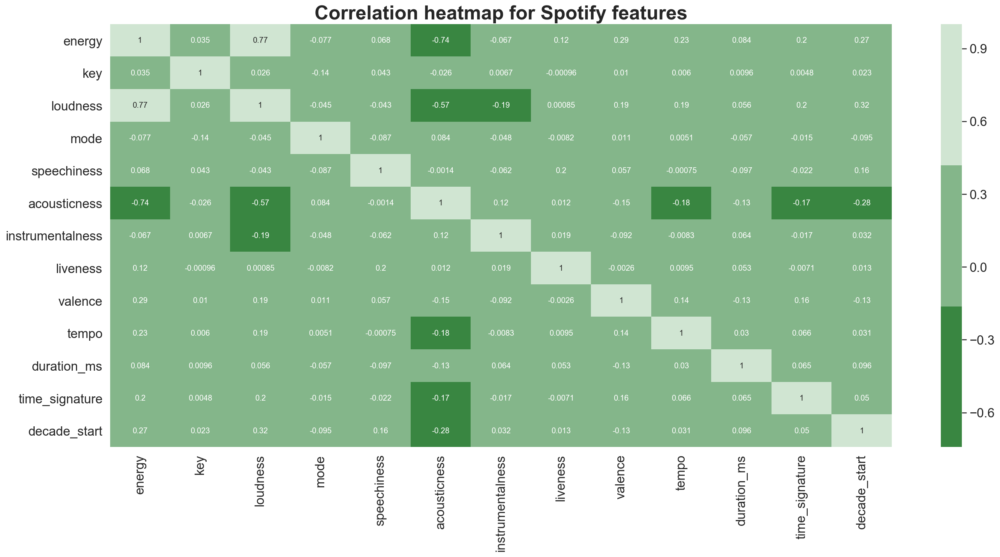

In [73]:
fig, ax = plt.subplots(figsize=[22.5,10])
sns.heatmap(clean.iloc[:,10:].corr(), annot=True, ax=ax, annot_kws={'fontsize': 10}, cmap=cmap)
plt.title('Correlation heatmap for Spotify features', fontsize=25, fontweight='extra bold')
plt.show()

# N.B. Positive linear correlation works for loudness and decades, implying linear regression could be possible
# N.B.2 The correlations between loudness-energy, and valence-danceability. These make logical sense,
# but will need to be addressed through regularisation or PCA

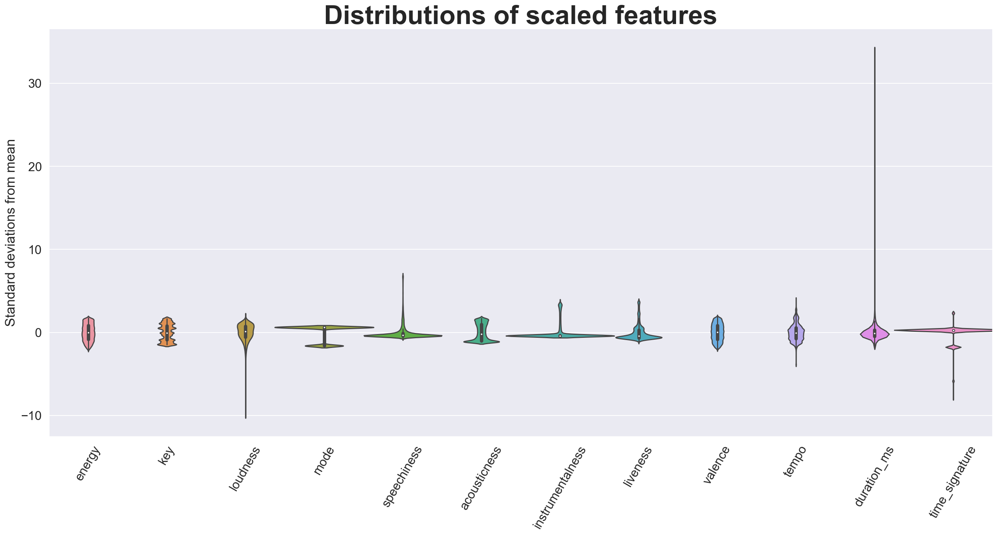

In [74]:
# Let's look at the distribution of the features

scaler = StandardScaler()

scaled = pd.DataFrame(scaler.fit_transform(clean.iloc[:,10:-2]), columns=clean.iloc[:,10:-2].columns)

plt.figure(figsize=[22.5,10])
sns.violinplot(data=scaled, width=1.5)
plt.xticks(rotation=60)
plt.title('Distributions of scaled features', fontsize=35, fontweight='extra bold')
plt.ylabel('Standard deviations from mean')
plt.show()

In [81]:
# Lots of outliers in duration_ms. Let's investigate which tracks are 20mins+
clean[clean.duration_ms>1200000].sort_values('duration_ms')

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start,track_ext
39852,The Jimi Hendrix Experience,"People, Hell & Angels",spotify:album:7iKj5K4J0Isp6rZtbETOiM,Ezy Ryder/MLK Jam (Captain Coconut),2013-03-06,6B44VpURGXTpAKvFe3XELY,spotify:track:6B44VpURGXTpAKvFe3XELY,https://api.spotify.com/v1/tracks/6B44VpURGXTp...,https://api.spotify.com/v1/audio-analysis/6B44...,0.396,0.80900,1,-7.894,1,0.0631,0.013300,0.120000,0.3740,0.6040,133.137,1200653,4,2010,Ezy Ryder/MLK Jam (Captain Coconut)
7993,Miles Davis,Bitches Brew,spotify:album:3Q0zkOZEOC855ErOOJ1AdO,Pharaoh's Dance,1970-04-01,7eEp1mm5xRfPMpilLFUKwX,spotify:track:7eEp1mm5xRfPMpilLFUKwX,https://api.spotify.com/v1/tracks/7eEp1mm5xRfP...,https://api.spotify.com/v1/audio-analysis/7eEp...,0.450,0.52000,11,-10.279,1,0.0402,0.490000,0.380000,0.1560,0.3290,84.743,1204067,4,1970,Pharaoh's Dance
39540,Grateful Dead,30 Days Of Dead 2013,spotify:album:0nTHr94uQQ315KvwrPuUW2,Scarlet Begonias/Fire On The Mountain - Live a...,2013-01-01,5DqW6VZ6FurVVjITFivwGM,spotify:track:5DqW6VZ6FurVVjITFivwGM,https://api.spotify.com/v1/tracks/5DqW6VZ6FurV...,https://api.spotify.com/v1/audio-analysis/5DqW...,0.507,0.34500,4,-19.474,1,0.0588,0.706000,0.093800,0.9780,0.6610,147.237,1211613,4,2010,Scarlet Begonias/Fire On The Mountain
39465,Grateful Dead,30 Days Of Dead 2012,spotify:album:4QPyY5VUoSP22WiDAvCMVl,That's It For The Other One>Cosmic Charlie - L...,2012-12-04,1Dz1HC8QuAfCguPJonqiow,spotify:track:1Dz1HC8QuAfCguPJonqiow,https://api.spotify.com/v1/tracks/1Dz1HC8QuAfC...,https://api.spotify.com/v1/audio-analysis/1Dz1...,0.470,0.18800,11,-20.350,0,0.0435,0.964000,0.299000,0.8480,0.4620,106.390,1221080,4,2010,That's It For The Other One>Cosmic Charlie
40874,Duke Ellington,In Gröna Lund 1963,spotify:album:0NpaujWqfdgHPWdynYmquM,Suite Thursday: Misfit Blues / Schwiphti / Zwe...,2014-05-14,3xlbENa6rt4X4bAcHLcOmW,spotify:track:3xlbENa6rt4X4bAcHLcOmW,https://api.spotify.com/v1/tracks/3xlbENa6rt4X...,https://api.spotify.com/v1/audio-analysis/3xlb...,0.432,0.29600,0,-16.594,0,0.1530,0.899000,0.031600,0.7370,0.4530,84.392,1223400,4,2010,Suite Thursday: Misfit Blues / Schwiphti / Zwe...
40870,John Coltrane,In Gröna Lund 1963,spotify:album:0NpaujWqfdgHPWdynYmquM,Suite Thursday: Misfit Blues / Schwiphti / Zwe...,2014-05-14,3xlbENa6rt4X4bAcHLcOmW,spotify:track:3xlbENa6rt4X4bAcHLcOmW,https://api.spotify.com/v1/tracks/3xlbENa6rt4X...,https://api.spotify.com/v1/audio-analysis/3xlb...,0.432,0.29600,0,-16.594,0,0.1530,0.899000,0.031600,0.7370,0.4530,84.392,1223400,4,2010,Suite Thursday: Misfit Blues / Schwiphti / Zwe...
29090,Grateful Dead,Dick's Picks Vol. 26: 4/26/69 (Electric Theate...,spotify:album:50rpHqRFD3K7bCTRBtraGH,Turn On Your Lovelight [Live At Electric Theat...,2002-01-01,69jPhAUzG2fyzkzep6E61V,spotify:track:69jPhAUzG2fyzkzep6E61V,https://api.spotify.com/v1/tracks/69jPhAUzG2fy...,https://api.spotify.com/v1/audio-analysis/69jP...,0.516,0.44300,9,-13.804,1,0.0496,0.835000,0.140000,0.4550,0.7680,109.932,1236627,4,2000,Turn On Your Lovelight [Live At Electric Theat...
31846,Grateful Dead,Download Series Vol. 6: 3/17/68 (Carousel Ball...,spotify:album:04BKBau3lJBVp0xY5wzmPW,Caution [Do Not Stop On Tracks] [Live At Carou...,2005-01-01,1GoQbzyQOgwxEXdlaQXWsI,spotify:track:1GoQbzyQOgwxEXdlaQXWsI,https://api.spotify.com/v1/tracks/1GoQbzyQOgwx...,https://api.spotify.com/v1/audio-analysis/1GoQ...,0.403,0.71000,9,-12.361,1,0.0704,0.293000,0.632000,0.2690,0.6950,136.196,1254773,4,2000,Caution [Do Not Stop On Tracks] [Live At Carou...
40703,Grateful Dead,30 Days Of Dead 2014,spotify:album:362ZgIzLaPzCvucBJSTKX6,Help On The Way/Slipknot!/Franklin's Tower - L...,2014-01-01,23zpQRL2J1mw8bB7RZh1Ub,spotify:track:23zpQRL2J1mw8bB7RZh1Ub,https://api.spotify.com/v1/tracks/23zpQRL2J1mw...,https://api.spotify.com/v1/audio-analysis/23zp...,0.414,0.39800,2,-20.421,

In [82]:
# We'll cut off at Miles Davis' Pharaoh's Dance, the last genuine single-track epic
# (the rest being mixes & interviews)

clean = clean[clean.duration_ms<1204068]

Duration can be explained as a cluster of songs around the 3-5min mark with several long epics.

Loudness, meanwhile, has a hard cutoff at 0, and therefore the long tail comes at the lower end.

Finally, note that mode is binary, between 1 (major) and 0 (minor) and that the time signature is overwhelmingly 4 (as in a 4/4 beat). The recentness of the data, coupled with the prevalence of the [four-to-the-floor beat](https://en.wikipedia.org/wiki/Four_on_the_floor_(music)) in recent pop music, makes this understandable.

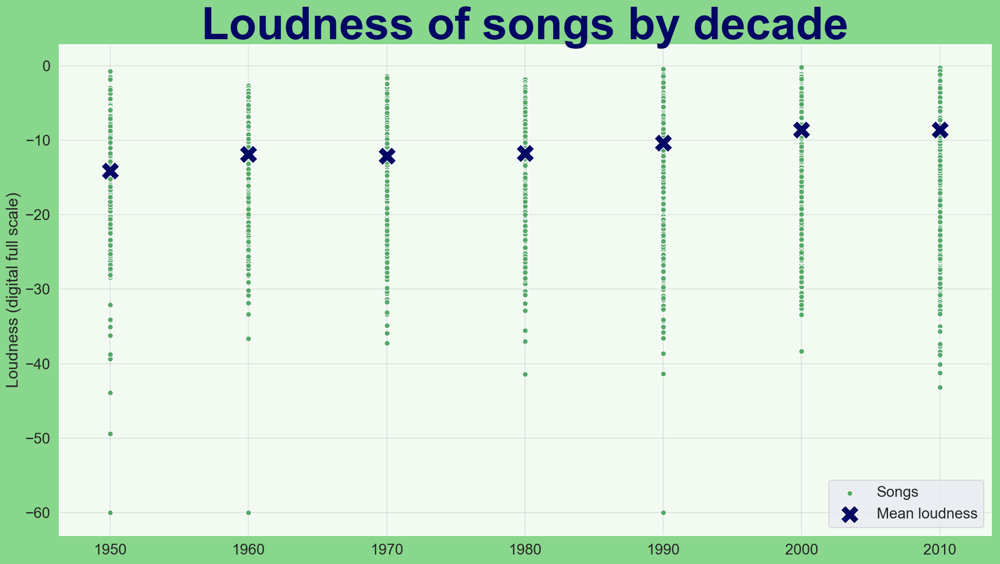

In [83]:
means = clean.groupby('decade_start').agg({'loudness':'mean'})


fig, ax = plt.subplots(figsize=[18.5,10])
points = sns.scatterplot(clean.decade_start, clean.loudness, ax=ax, color='g', data=clean, label='Songs')
sns.scatterplot(x=means.index, y='loudness', data=means, color='g')

meanplot = sns.scatterplot(x=means.index, y='loudness', data=means, color='xkcd:darkblue', s=400, marker='X', ax=ax, label='Mean loudness')
plt.title('Loudness of songs by decade', fontsize=50, fontweight='extra bold', color='xkcd:darkblue')
plt.xlabel('')
plt.ylabel('Loudness (digital full scale)')

fig.patch.set_alpha(0.5)
ax.patch.set_alpha(0.9)
plt.grid(c='k', alpha=0.1)

ax.set_facecolor('w')

fig.set_facecolor('xkcd:green')


plt.show()

# N.B. spread greatly increases in recent times, but mean goes up!

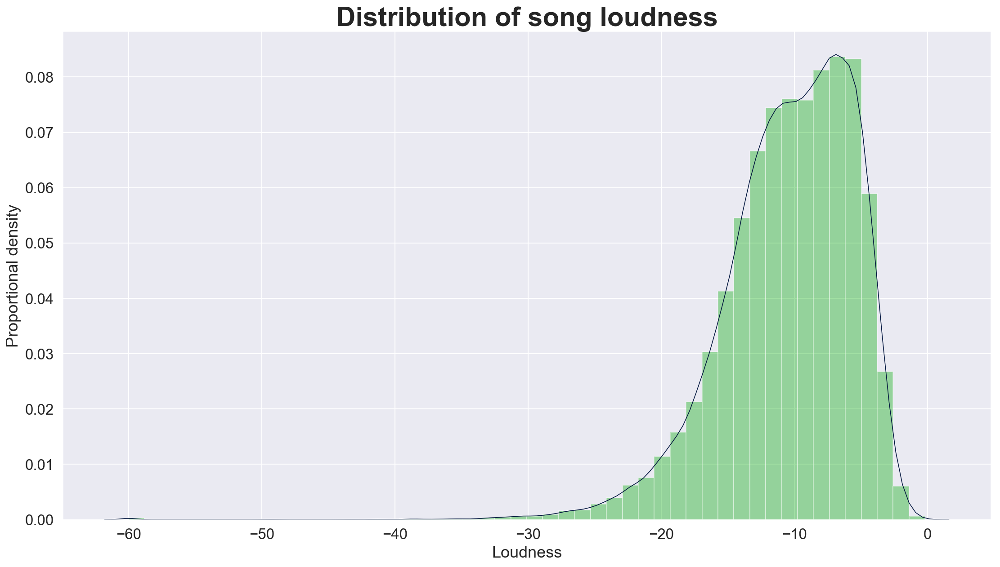

In [84]:
plt.figure(figsize=[18.5,10])
sns.distplot(clean.loudness, color='xkcd:green', kde_kws={'linewidth': '0.8', 'color': 'xkcd:navy'})
plt.title('Distribution of song loudness', fontsize=30, fontweight='bold')
plt.xlabel('Loudness')
plt.ylabel('Proportional density')

plt.show()

Note the long tail on the left hand side, with a hard cutoff at 0.

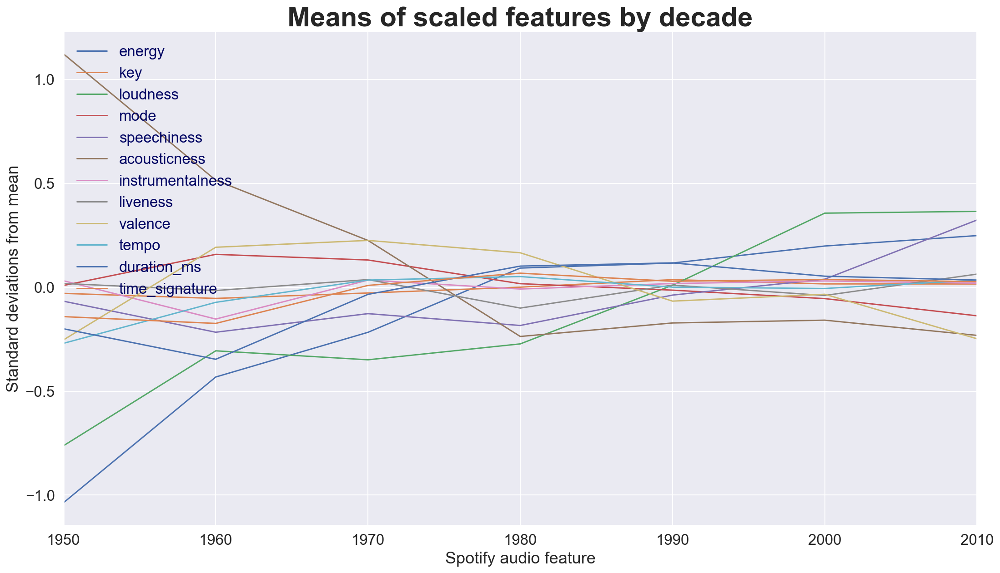

In [85]:
scaled_plot = scaled.copy()
scaled_plot['decade_start'] = clean['decade_start'].astype(int)
agged = scaled_plot.groupby('decade_start').agg({col: 'mean' 
                                                 for col in scaled_plot.iloc[:,:-1].columns})

fig, ax = plt.subplots(figsize=[18,10])
agged.plot(ax=ax)
plt.title('Means of scaled features by decade', fontsize=30, fontweight='extra bold')
plt.ylabel('Standard deviations from mean')
plt.xlabel('Spotify audio feature')
leg = plt.legend(framealpha = 0, loc = 'best')
for text in leg.get_texts():
    plt.setp(text, color = 'xkcd:darkblue')

plt.show()

#### Acousticness down, loudness and duration up - the reasoning behind these changes is explored below

## Timeseries analysis

Loudness has already been shown to predict a song's era well. Let's look at the trends behind this, and cross-reference with what we know about the period.

In [86]:
# Make a timeseries-indexed version of the dataset

bydate = clean.sort_values('release_date').set_index('release_date')
bydate['month'] = bydate.index.month
bydate['day'] = bydate.index.dayofyear

### Loudness trends

'Loudness' in music has been a hotly-debated topic over the last few decades. Even as early as the 1940s, when jukeboxes were popularised, musicians began to notice that they could make their tracks stand out more by having them produced to maximum volume, because the jubebox would be set at a predetermined volume allowing for variation between songs. The ensuing [loudness war](https://en.wikipedia.org/wiki/Loudness_war) would come to define music mastering over the decades, as producers used whatever technology was available at the time to [compress](https://en.wikipedia.org/wiki/Dynamic_range_compression) and then boost a track to as loud as it could be played.

When, in the 80s, affordable production software was released, any amateur could now boost a track to a much louder volume than previously possible. We can see this reflected in the data: the rolling yearly mean of loudness is very variant pre-1980 (largely due to a lack of data), but after the 1984 release of [Pro Tools Digital Audio Workstation](https://www.pro-tools-expert.com/home-page/2018/2/19/the-history-of-pro-tools-1984-to-1993), one of the earliest popular DAWs, there is a steady increase in loudness as it becomes easier and easier to max out a track's volume.

While the [debate still rages](https://www.bbc.co.uk/news/entertainment-arts-35250557) as to whether this overbearing production compromises the nuance in music, it's a great help for our modelling purposes.

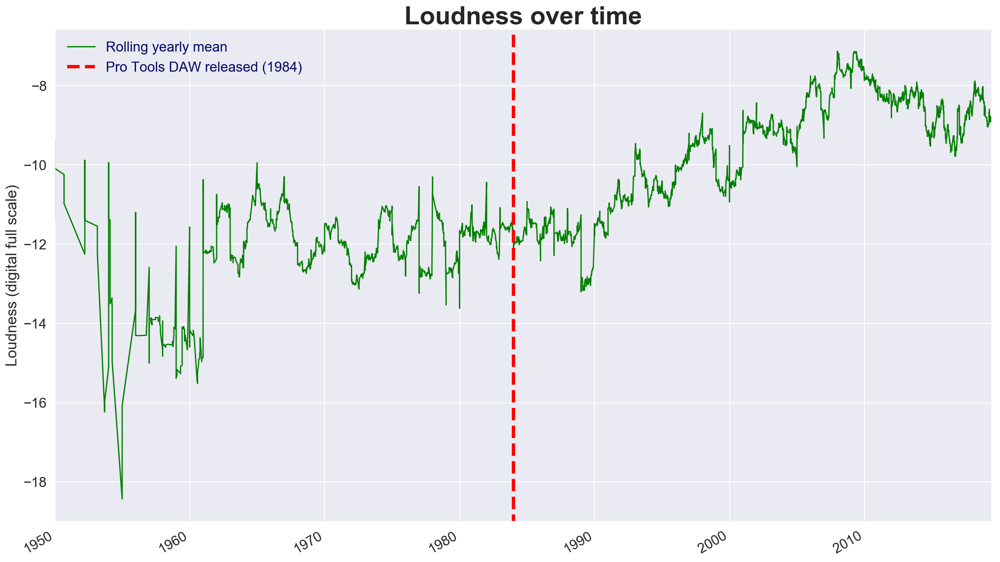

In [87]:
fig, ax = plt.subplots(figsize=[20, 12])
bydate[['loudness']].rolling('365D').mean().plot(ax=ax, color='green')
ax.set_title('Loudness over time', fontdict={'fontsize': 30, 'fontweight': 'extra bold'})
ax.set_xlabel('')
ax.set_ylabel('Loudness (digital full scale)')
ax.legend('')
plt.axvline(datetime.date(1984, 1, 1), -1, 3, color='red', linewidth=4, linestyle='--')
leg = plt.legend(['Rolling yearly mean',
            'Pro Tools DAW released (1984)'], framealpha = 0, loc = 'best')
for text in leg.get_texts():
    plt.setp(text, color = 'xkcd:darkblue')
plt.show()

### Acousticness

Spotify's `acousticness` feature is a confidence measure of whether a track is acoustic or not.

The conflict between electronic and acoustic music has been around longer than you might think. While the first synthesizer (using electricity as a sound source) was developed as early as [the 19th century](https://en.wikipedia.org/wiki/Electronic_musical_instrument#Early_examples), it was not until much later that they became popularised. One might recognise the slightly kitsch-sounding [theremin](https://en.wikipedia.org/wiki/Theremin) from the soundtracks of 50s films such as *[The Day the Earth Stood Still (1951)](https://en.wikipedia.org/wiki/The_Day_the_Earth_Stood_Still)*, and a variant of it, the electrotheremin, was used in The Beach Boys' 1966 hit *[Good Vibrations](https://en.wikipedia.org/wiki/Good_Vibrations)*.

With the 1977 release of Donna Summer's [I Feel Love](https://en.wikipedia.org/wiki/I_Feel_Love), produced by Italo Disco pioneer [Giorgio Moroder](https://en.wikipedia.org/wiki/Giorgio_Moroder), the synth established itself as a defining feature of contemporary music, and acoustic instruments became a thing of the past.

We can see the mean acousticness falling over this time period, with the events in question marking this decline, before stablizing at a lower level in the 90s.

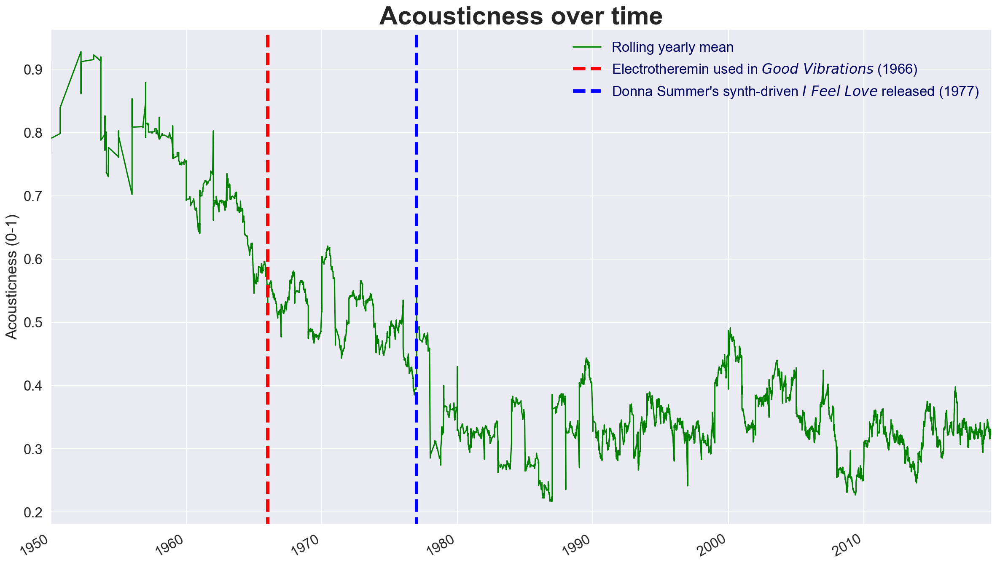

In [89]:
fig, ax = plt.subplots(figsize=[20, 12])
bydate[['acousticness']].rolling('365D').mean().plot(ax=ax, color='green')
ax.set_title('Acousticness over time', fontdict={'fontsize': 30, 'fontweight': 'extra bold'})
ax.set_xlabel('')
ax.set_ylabel('Acousticness (0-1)')
ax.legend('')
plt.axvline(datetime.date(1966, 1, 1), -1, 3, color='red', linewidth=4, linestyle='--')
plt.axvline(datetime.date(1977, 1, 1), -1, 3, color='blue', linewidth=4, linestyle='--')

leg = plt.legend(['Rolling yearly mean',
            'Electrotheremin used in $\it{Good\ Vibrations}$ (1966)',
            'Donna Summer\'s synth-driven $\it{I\ Feel\ Love}$ released (1977)'], framealpha = 0, loc = 'best')
for text in leg.get_texts():
    plt.setp(text, color = 'xkcd:darkblue')
plt.show()

#### Looking below, most of the least acoustic tracks seem to come from the 1960s. Surprising, no?
It turns out there is an [entire album](https://open.spotify.com/track/5jlzKsE5RilZcfIp6yaPoX?si=44Ezs9RcQqm9xAshJEc30Q) of empty tracks by Connie Francis clouding the data. An oversight by Spotify, then...

In [94]:
clean.sort_values('acousticness').head(5)

,artist,album_name,album_uri,track,release_date,id,song_uri,track_href,analysis_url,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,decade_start,track_ext
1539,Connie Francis,Connie Francis Sings Jewish Favorites,spotify:album:6NCnLHUe0vi4EGpiP9Kw3O,Hava Nagilah,1960-01-01,0zr7DJGTPUfAUmjM7crmt2,spotify:track:0zr7DJGTPUfAUmjM7crmt2,https://api.spotify.com/v1/tracks/0zr7DJGTPUfA...,https://api.spotify.com/v1/audio-analysis/0zr7...,0.0,0.000,0,-60.000,0,0.0,0.0,0.0,0.0,0.0,0.0,179466,0,1960,Hava Nagilah
1550,Connie Francis,Connie Francis Sings Jewish Favorites,spotify:album:6NCnLHUe0vi4EGpiP9Kw3O,Oifen Pripetchik,1960-01-01,1M1f5oGecsLB7BnVrZFgD4,spotify:track:1M1f5oGecsLB7BnVrZFgD4,https://api.spotify.com/v1/tracks/1M1f5oGecsLB...,https://api.spotify.com/v1/audio-analysis/1M1f...,0.0,0.000,0,-60.000,0,0.0,0.0,0.0,0.0,0.0,0.0,172159,0,1960,Oifen Pripetchik
1553,Connie Francis,Connie Francis Sings Jewish Favorites,spotify:album:6NCnLHUe0vi4EGpiP9Kw3O,O Mein Papa,1960-01-01,7Ad5lOQRW29NTptXpazQjM,spotify:track:7Ad5lOQRW29NTptXpazQjM,https://api.spotify.com/v1/tracks/7Ad5lOQRW29N...,https://api.spotify.com/v1/audio-analysis/7Ad5...,0.0,0.000,0,-60.000,0,0.0,0.0,0.0,0.0,0.0,0.0,209333,0,1960,O Mein Papa
22395,Janet Jackson,Janet,spotify:album:7qIuZgsMkRuh7rzi4qVcpg,Back,1993-05-18,2d7W1B4rrPYsZ4V5YQPbrJ,spotify:track:2d7W1B4rrPYsZ4V5YQPbrJ,https://api.spotify.com/v1/tracks/2d7W1B4rrPYs...,https://api.spotify.com/v1/audio-analysis/2d7W...,0.0,0.425,4,-21.103,1,0.0,0.0,0.0,0.0,0.0,0.0,4267,0,1990,Back
1549,Connie Francis,Connie Francis Sings Jewish Favorites,spotify:album:6NCnLHUe0vi4EGpiP9Kw3O,"Yossel, Yossell",1960-01-01,7DdJC1TZseBcLxuvQPXCy4,spotify:track:7DdJC1TZseBcLxuvQPXCy4,https://api.spotify.com/v1/tracks/7DdJC1TZseBc...,https://api.spotify.com/v1/audio-analysis/7DdJ...,0.0,0.000,0,-60.000,0,0.0,0.0,0.0,0.0,0.0,0.0,153039,0,1960,"Yossel, Yossell"


The easiest way of cleaning these up (as well as any remaining snippets of speech) is actually to remove everything with a time signature, tempo and instrumentalness of zero.

In [116]:
clean = clean[clean.loc[:, ['instrumentalness', 'tempo', 'time_signature']].sum(axis=1) != 0]

## Librosa

It's time for a new package - why, you ask?

Below is the low-level analysis given by Spotify on one song, from which they derive the features.

In [102]:
pprint(sp.audio_analysis('spotify:track:0PSZW7I65ehl722xl3wLNi'))

{'bars': [{'confidence': 0.552, 'duration': 2.48291, 'start': 0.45765},
          {'confidence': 0.703, 'duration': 2.46855, 'start': 2.94056},
          {'confidence': 0.168, 'duration': 2.45139, 'start': 5.40911},
          {'confidence': 0.492, 'duration': 2.45061, 'start': 7.86051},
          {'confidence': 0.022, 'duration': 2.51234, 'start': 10.31112},
          {'confidence': 0.573, 'duration': 2.4842, 'start': 12.82345},
          {'confidence': 0.355, 'duration': 2.39088, 'start': 15.30765},
          {'confidence': 0.685, 'duration': 2.37093, 'start': 17.69854},
          {'confidence': 0.769, 'duration': 2.38067, 'start': 20.06947},
          {'confidence': 0.562, 'duration': 2.40542, 'start': 22.45014},
          {'confidence': 0.118, 'duration': 2.42911, 'start': 24.85556},
          {'confidence': 0.544, 'duration': 2.42094, 'start': 27.28467},
          {'confidence': 0.069, 'duration': 2.43312, 'start': 29.70561},
          {'confidence': 0.225, 'duration': 2.50155, 'st

                          -5.888]},
              {'confidence': 0.689,
               'duration': 0.38735,
               'loudness_max': -9.705,
               'loudness_max_time': 0.01922,
               'loudness_start': -16.668,
               'pitches': [1.0,
                           0.642,
                           0.394,
                           0.19,
                           0.239,
                           0.238,
                           0.432,
                           0.47,
                           0.101,
                           0.084,
                           0.122,
                           0.405],
               'start': 21.40971,
               'timbre': [46.446,
                          87.468,
                          -19.072,
                          32.528,
                          -14.699,
                          -2.558,
                          -36.778,
                          27.003,
                          2.27,
                    

                          16.181,
                          -31.167,
                          -29.773,
                          15.592,
                          3.311,
                          -0.059]},
              {'confidence': 0.679,
               'duration': 0.30721,
               'loudness_max': -16.342,
               'loudness_max_time': 0.04497,
               'loudness_start': -22.789,
               'pitches': [0.184,
                           0.12,
                           0.154,
                           0.295,
                           0.282,
                           0.124,
                           0.864,
                           1.0,
                           0.609,
                           0.14,
                           0.05,
                           0.099],
               'start': 46.23692,
               'timbre': [40.396,
                          24.017,
                          14.176,
                          18.486,
                    

              {'confidence': 0.363,
               'duration': 0.30195,
               'loudness_max': -13.661,
               'loudness_max_time': 0.02825,
               'loudness_start': -18.909,
               'pitches': [1.0,
                           0.644,
                           0.273,
                           0.074,
                           0.1,
                           0.086,
                           0.11,
                           0.212,
                           0.109,
                           0.057,
                           0.044,
                           0.329],
               'start': 67.80875,
               'timbre': [41.833,
                          53.352,
                          -10.419,
                          27.889,
                          5.479,
                          -38.608,
                          -13.629,
                          -8.324,
                          -1.442,
                          -12.677,
                    

                          -71.391,
                          -26.717,
                          41.32,
                          -44.908,
                          -1.556]},
              {'confidence': 0.768,
               'duration': 0.28399,
               'loudness_max': -11.005,
               'loudness_max_time': 0.0379,
               'loudness_start': -19.797,
               'pitches': [1.0,
                           0.273,
                           0.134,
                           0.21,
                           0.189,
                           0.14,
                           0.196,
                           0.403,
                           0.106,
                           0.168,
                           0.438,
                           0.695],
               'start': 92.36934,
               'timbre': [45.854,
                          41.78,
                          35.044,
                          21.813,
                          20.65,
                     

While it seems comprehensive, it is actually only useful for noting when the beats are in a track. The variable `timbre`, with its 12 coefficients, is the one that most closely corresponds to the acoustic properties of each section. However, the [docs](https://developer.spotify.com/documentation/web-api/reference/tracks/get-audio-analysis/) give only a vague description of what each one relates to. By raising an [issue](https://github.com/spotify/web-api/issues/1248) on GitHub I learnt that these are derived from PCA, and we can't get any more out of them without knowledge of the underlying audio files.

Instead, we can use `librosa` to represent acoustic properties of songs when given an audio file

In [26]:
from __future__ import print_function
import matplotlib.style as ms
ms.use('seaborn-muted')
%matplotlib inline

# and IPython.display for audio output
import IPython.display

# Librosa for audio
import librosa
# And the display module for visualization
import librosa.display

In [27]:
def spectrogram(path):
    '''
    Takes an audio file and represents it with a mel spectrogram using librosa
    '''
    y, sr = librosa.load(path)
    
    # Let's make and display a mel-scaled power (energy-squared) spectrogram
    S = librosa.feature.melspectrogram(y, sr=sr, n_mels=128)

    # Convert to log scale (dB). We'll use the peak power (max) as reference.
    log_S = librosa.power_to_db(S, ref=np.max)

    # Make a new figure
    plt.figure(figsize=(12,4))

    # Display the spectrogram on a mel scale
    # sample rate and hop length parameters are used to render the time axis
    librosa.display.specshow(log_S, sr=sr, x_axis='time', y_axis='mel', cmap=cmap)

    # Put a descriptive title on the plot
    plt.title(f'Spectrogram of... ?')

    # draw a color bar
    plt.colorbar(format='%+02.0f dB')

    # Make the figure layout compact
    plt.tight_layout()

### Spectrograms with Librosa

A [spectrogram](https://en.wikipedia.org/wiki/Spectrogram) is a way of visualising signal frequencies as they change over time. Normalised, as usual, to digital full scale, where 0dB is the loudest representable sound, they display amplitude at various frequencies with time on the x-axis.

Now look at the two spectrograms below. One of them comes from the 60s, the other from the 2010s. 

**Can you tell which is which?**

In [28]:
cmap = sns.cubehelix_palette(8, start=4.2, rot=1, as_cmap=True, reverse=True)

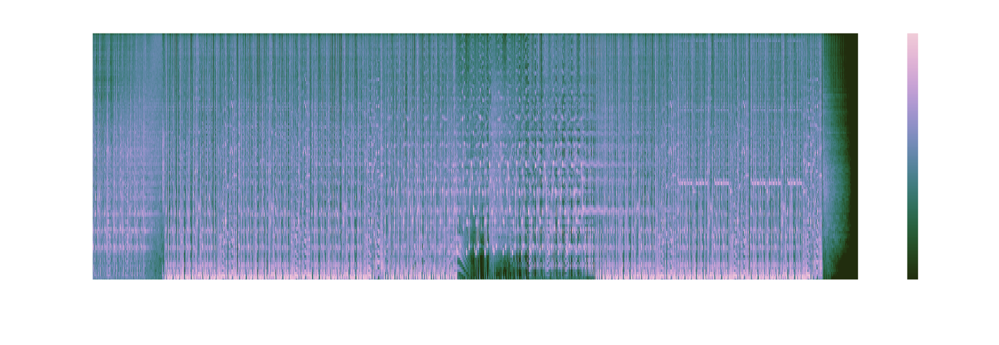

In [29]:
spectrogram("librosa/spect1.mp3")

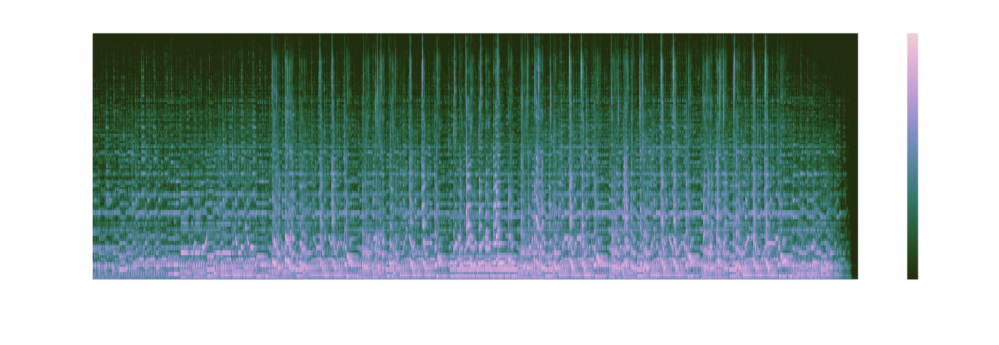

In [30]:
spectrogram("librosa/spect2.mp3")

# Answer (no peeking!)

The first is Deadmau5 and Wolfgang Gartner's *Animal Rights*, an [EDM](https://en.wikipedia.org/wiki/Electronic_dance_music)/Progressive house hit from 2010.

The second is Jefferson Airplane's *Comin' Back To Me*, a psychedelic folk number from 1967.

With spectrograms, we can *see* the effect of 43 years' technological development in music. Namely, The signal is far stronger in the first graph, as well as far more consistent throughout the spectrum. This is because, in the era of studio recordings with very little post production, variation in auditory space could only come from deliberate instrumentation and arrangement.

The production values of modern electronic music, by contrast, are geared towards loud, punchy tracks that are memorable in clubs and stand out on a radio playlist, because this generates more plays for an artist. This is an inevitable conclusion of the [loudness war](https://en.wikipedia.org/wiki/Loudness_war), in which better equipment and the need to distinguish oneself from the crowd has supposedly led to uniformly overpowering music in the modern day. Moreover, by making use of the huge sound libraries available to modern artists, as well as [equalisation](https://en.wikipedia.org/wiki/Equalization_(audio)), today's producers deliberately place each of their instruments at different frequency bands so that each of them stand out, resulting in the greater frequency coverage you can see in the top graph.

# Modelling

Now that our data is cleaned and ready, let's try tuning a Logistic Regression model.

In [118]:
kf = StratifiedKFold(5, True, 10)

predictors = clean.iloc[:, 10:-1].copy()
y = predictors.pop('decade_start')

X_train, X_test, y_train, y_test = train_test_split(predictors, y, stratify=y, test_size=0.2)

scaler = StandardScaler()
Xs_train = scaler.fit_transform(X_train)
Xs_test = scaler.transform(X_test)

lr = LogisticRegression()

params = {'penalty': ['l1', 'l2'],
         'C': np.logspace(-8, 0, 20),
         'class_weight': [None, 'balanced'],
         'solver': ['saga']}

gs = GridSearchCV(lr, param_grid=params, verbose=1, n_jobs=-1, cv=kf)

gs.fit(Xs_train, y_train)

print('Baseline:', max(y.value_counts(normalize=True)))
print('Train score:', gs.score(Xs_train, y_train))
print('Test score:', gs.score(Xs_test, y_test))

Fitting 5 folds for each of 80 candidates, totalling 400 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 176 tasks      | elapsed:   24.1s
[Parallel(n_jobs=-1)]: Done 400 out of 400 | elapsed:  1.4min finished


Baseline: 0.21527220692496152
Train score: 0.3310748550056914
Test score: 0.3300813008130081


In [119]:
gs.best_params_

{'C': 1.0, 'class_weight': None, 'penalty': 'l2', 'solver': 'saga'}

### Bagging

The logistic regression model generalised decently, but could be improved. To improve its variance, we employ ensemble methods such as bagging, which bootstraps (resamples with with replacement) randomly and trains several models based on the different samples generated, before using all of them to *vote* on the class of each data point.

In [125]:
lr2 = LogisticRegression(C=1, penalty='l2', solver='saga')
bc = BaggingClassifier()

params = {'n_estimators': [80],
         'max_features': [0.5, 0.7, 0.9, 1.0],
          'max_samples': [0.05, 0.1, 0.2, 0.3, 0.5],
         'base_estimator': [lr2]}

gs2 = GridSearchCV(bc, params, cv=kf, verbose=1, n_jobs=-2)
gs2.fit(Xs_train, y_train)

print('Baseline:', max(y.value_counts(normalize=True)))
print('Train score:', gs2.score(Xs_train, y_train))
print('Test score:', gs2.score(Xs_test, y_test))

Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 11 concurrent workers.
[Parallel(n_jobs=-2)]: Done  28 tasks      | elapsed:  8.7min
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed: 31.0min finished


Baseline: 0.21527220692496152
Train score: 0.3314813811046669
Test score: 0.33018970189701896


In [126]:
gs2.best_params_

{'base_estimator': LogisticRegression(C=1, class_weight=None, dual=False, fit_intercept=True,
           intercept_scaling=1, max_iter=100, multi_class='warn',
           n_jobs=None, penalty='l2', random_state=None, solver='saga',
           tol=0.0001, verbose=0, warm_start=False),
 'max_features': 1.0,
 'max_samples': 0.3,
 'n_estimators': 80}

In [127]:
preds = gs.predict(Xs_test)

In [128]:
confusion_matrix(y_test, preds)

array([[   0,  149,   63,    7,    2,   21,   45],
       [   1,  528,  228,   61,   28,  170,  150],
       [   1,  261,  426,  223,   71,  244,  224],
       [   0,   92,  232,  330,   61,  153,  219],
       [   1,  185,  232,  190,   88,  263,  470],
       [   1,  201,  191,   56,   44,  490,  837],
       [   2,  188,  142,   60,   37,  374, 1183]])

In [129]:
print(classification_report(y_test, preds))

              precision    recall  f1-score   support

        1950       0.00      0.00      0.00       287
        1960       0.33      0.45      0.38      1166
        1970       0.28      0.29      0.29      1450
        1980       0.36      0.30      0.33      1087
        1990       0.27      0.06      0.10      1429
        2000       0.29      0.27      0.28      1820
        2010       0.38      0.60      0.46      1986

   micro avg       0.33      0.33      0.33      9225
   macro avg       0.27      0.28      0.26      9225
weighted avg       0.31      0.33      0.30      9225



The model score is marginally improved, but it suffers from differing class sizes. We will now try to address this with oversampling methods (where less prominent classes are randomly resampled to bring them up to the numbers of the biggest class).

In addition, we must account for multicollinearity in the features (e.g. the high correlation between loudness and energy), so that the model is not prevented from generalising well by overaccounting for similar attributes. Previously, we attempted to negate this effect by tuning different amounts of regularization with the 'C' parameter in a logistic regression model, which scales down the importance of some features by adding their coefficients (Lasso) or the square of their coefficients (Ridge) into the loss function.

On this occasion, we handle it by implementing a random forest algorithm, which combines the earlier bagging methods with random feature selection (to prevent a couple of more important features from dominating) in a way that is optimized for decision tree models.

### Oversampling with SMOTE-NC

The Synthetic Minority Over-sampling Technique for Nominal and Continuous, or SMOTE-NC, is an oversampling technique designed to handle both continuous and discrete data, and is therefore the best suited to our feature set.

In [131]:
kf = StratifiedKFold(5, True, 10)

predictors = clean.iloc[:, 9:-1].copy()
y = predictors.pop('decade_start')

X_train, X_test, y_train, y_test = train_test_split(predictors, y, stratify=y, test_size=0.2, shuffle=True)

scaler = StandardScaler()
Xs_train = scaler.fit_transform(X_train)
Xs_test = scaler.transform(X_test)

In [132]:
predictors.iloc[:, [2, 4, 12]].head()
# These are the categorical classes we will pass in

,key,mode,time_signature
0,8,1,4
1,7,0,4
2,5,0,4
3,5,1,4
4,5,0,3


In [134]:
sampler = SMOTENC([2, 4, 12], random_state=1)
X_resampled, y_resampled = sampler.fit_sample(Xs_train, y_train)

pd.Series(y_resampled).value_counts()

# The classes have now been balanced through oversampling

1950    7943
1980    7943
2010    7943
1970    7943
2000    7943
1960    7943
1990    7943
dtype: int64

In [153]:
rfc = RandomForestClassifier(n_estimators=300)

pipe = make_pipeline_imb(SMOTENC(categorical_features=[2, 4, 12], random_state=9),
                         rfc)

model_params = {
    'randomforestclassifier__min_samples_split':[2, 3, 5],
    'randomforestclassifier__max_depth':[None, 3, 5]
            }
gs = GridSearchCV(pipe, model_params, cv=5, iid=False, verbose=True, n_jobs=-2)    
gs.fit(Xs_train, y_train)
predictions = gs.best_estimator_.predict(Xs_test)

print('Baseline:', max(pd.DataFrame(y_resampled, columns=['decade_start']).decade_start.value_counts(normalize=True)))
print('Train score:', gs.best_estimator_.score(Xs_train, y_train))
print('Test score:', gs.best_estimator_.score(Xs_test, y_test))

Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 11 concurrent workers.
[Parallel(n_jobs=-2)]: Done  45 out of  45 | elapsed:  7.3min finished


Baseline: 0.14285714285714285
Train score: 0.9992411512819123
Test score: 0.47284552845528455


In [198]:
# Let's have a look at the misclassifications
def plot_cm(matrix, labels, figsize=[12, 8]):
    '''Plot a confusion matrix'''
    conf = pd.DataFrame(matrix, index = labels, columns= labels)
    conf.index.name = 'True label'
    conf.columns.name = 'Predicted label'
    plt.figure(figsize=figsize)
    sns.heatmap(conf, annot=True, annot_kws={'fontsize': 15}, cmap='BuGn', fmt='g')
    plt.show()

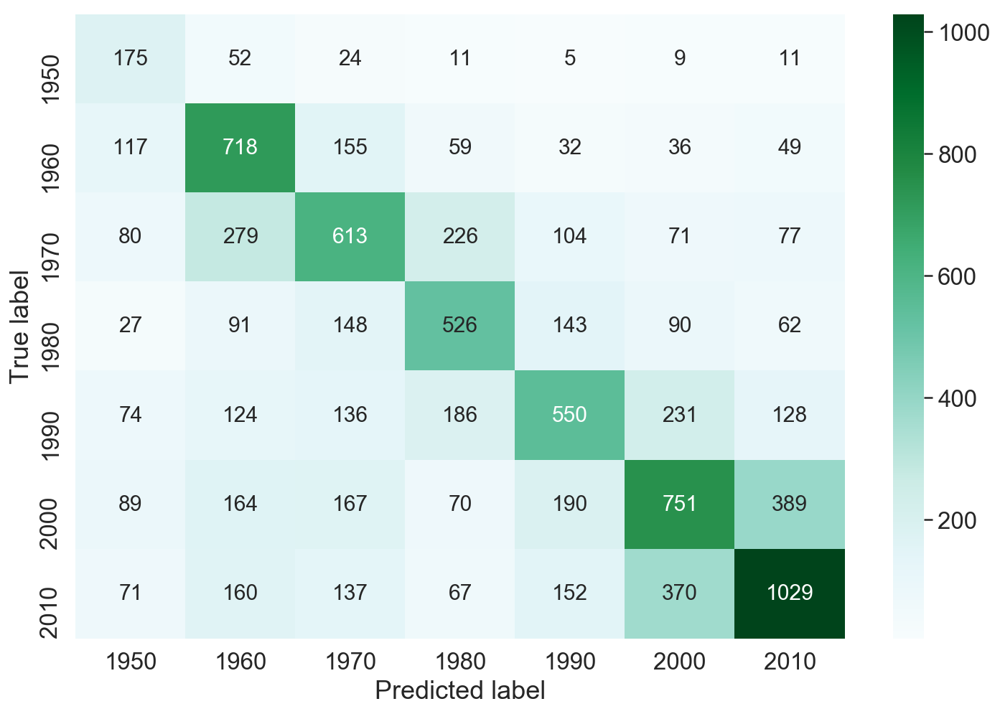

In [199]:
plot_cm(confusion_matrix(y_test, predictions), y.unique())

In [137]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

        1950       0.27      0.59      0.37       287
        1960       0.45      0.62      0.52      1166
        1970       0.45      0.43      0.44      1450
        1980       0.47      0.49      0.48      1087
        1990       0.47      0.38      0.42      1429
        2000       0.48      0.40      0.44      1820
        2010       0.58      0.52      0.55      1986

   micro avg       0.47      0.47      0.47      9225
   macro avg       0.45      0.49      0.46      9225
weighted avg       0.48      0.47      0.47      9225



Oversampling gives an even spread to the predictions, and helps to avoid simply predicting the biggest classes (2000 and 2010). We can see this effect in the improved macro averages of the precision and recall, which display an unweighted average across all classes. The misclassifications are telling here: the fact that adjacent decades are misclassified most often means the model is picking up real features of music over the years.

While oversampling helps minority classes be better represented, it tends to negatively impact the overall accuracy of the model. To avoid this, we run the random forest model with the original, imbalanced data.

### Random Forest without oversampling

We now return to methods similar to the Bagged DTC to further optimise the model.

In [200]:
rfc = RandomForestClassifier(n_estimators=300)

params = {
    'min_samples_split':[2, 3, 5],
    'max_depth':[None, 3, 5],
    'n_estimators': [300]
            }
Xs_train = pd.DataFrame(Xs_train, columns=predictors.columns)
Xs_test = pd.DataFrame(Xs_test, columns=predictors.columns)

rfc_gs = GridSearchCV(rfc, param_grid=params, cv=kf, iid=True, verbose=True, n_jobs=-2)    
rfc_gs.fit(Xs_train, y_train)

print('Baseline:', max(y.value_counts(normalize=True)))
print('Train score:', rfc_gs.score(Xs_train, y_train))
print('Test score:', rfc_gs.score(Xs_test, y_test))

Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 11 concurrent workers.
[Parallel(n_jobs=-2)]: Done  45 out of  45 | elapsed:  2.0min finished


Baseline: 0.21527220692496152
Train score: 0.9995663721610928
Test score: 0.482710027100271


In [201]:
best = rfc_gs.score(Xs_test, y_test)

Random forest combines bagging methods with random feature selection for each decision tree. This prevents some stronger features from dominating all the decision trees, helping to reduce the model's variance and let it generalise better. In this way, we get the highest score thus far, with 26.7% over the baseline. In fact, not only has the overall accuracy increased, but the precision and recall have barely been impacted by not balancing the classes.

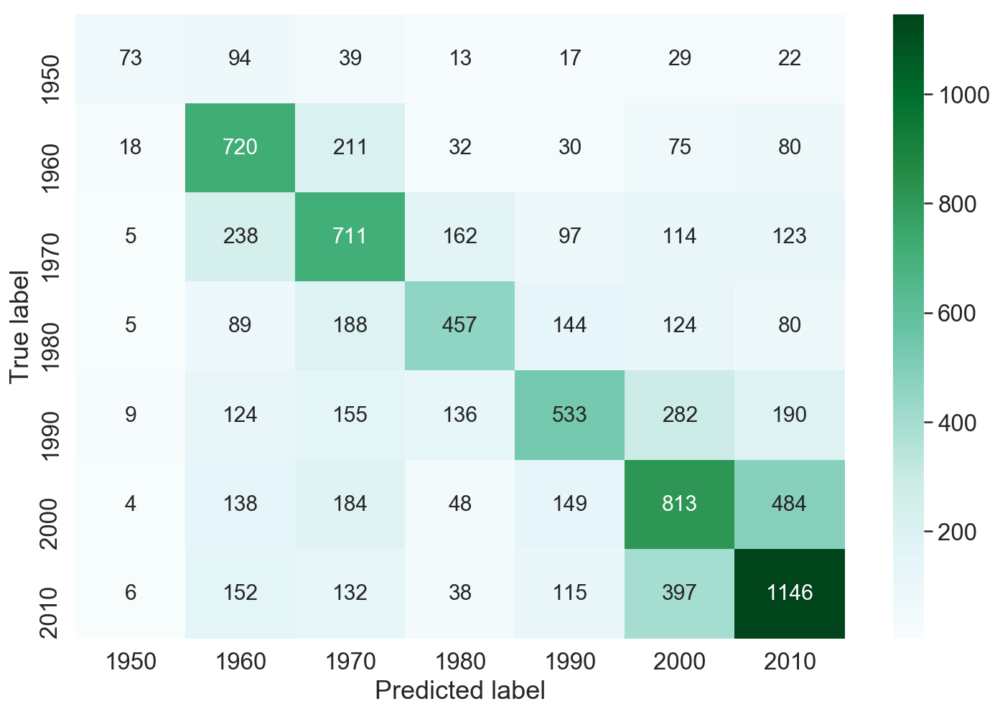

In [202]:
plot_cm(confusion_matrix(y_test, rfc_gs.predict(Xs_test)), y.unique())

In [204]:
print(classification_report(y_test, rfc_gs.predict(Xs_test)))

              precision    recall  f1-score   support

        1950       0.61      0.25      0.36       287
        1960       0.46      0.62      0.53      1166
        1970       0.44      0.49      0.46      1450
        1980       0.52      0.42      0.46      1087
        1990       0.49      0.37      0.42      1429
        2000       0.44      0.45      0.44      1820
        2010       0.54      0.58      0.56      1986

   micro avg       0.48      0.48      0.48      9225
   macro avg       0.50      0.45      0.46      9225
weighted avg       0.49      0.48      0.48      9225



## Evaluating the model

In [205]:
# Feature importance
fi = pd.DataFrame({col: [val] for col, val in zip(predictors.columns, rfc_gs.best_estimator_.feature_importances_)})
fi

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,0.089989,0.091584,0.05237,0.120272,0.012636,0.09218,0.098738,0.071184,0.081089,0.093484,0.084618,0.101303,0.010553


### Feature importance

This displays the frequency of the features' use weighted by how well they 'purify' from splitting, i.e. how accurately they divide the classes when moving to the next stage of the tree. The feature importance has been averaged, and will sum to 1.

In [206]:
fi.sum(axis=1)

0    1.0
dtype: float64

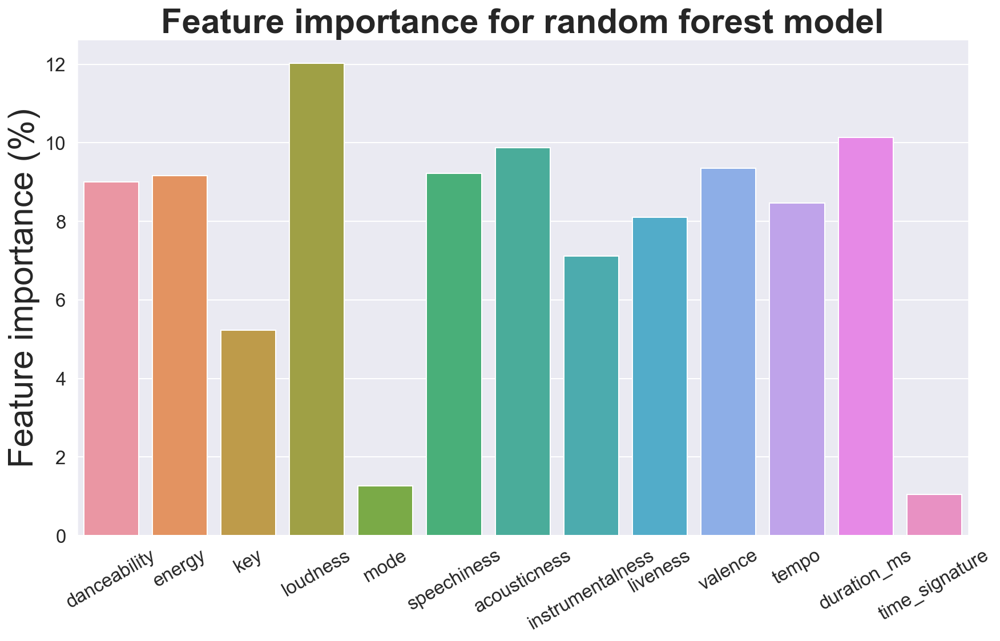

In [207]:
plt.figure(figsize=[14,8])
sns.barplot(data=fi*100)
plt.xticks(rotation=30)
plt.title('Feature importance for random forest model', fontsize=30, fontweight='extra bold')
plt.ylabel('Feature importance (%)', fontsize=30)

plt.show()

As we initially hypothesized, loudness is by far the most important feature across the decision trees. This means it was most effective at splitting the data into the correct classes (a metric called 'purity'), and was the most used feature. Let's plot one of the trees to see the process in action.

### Decision tree plot

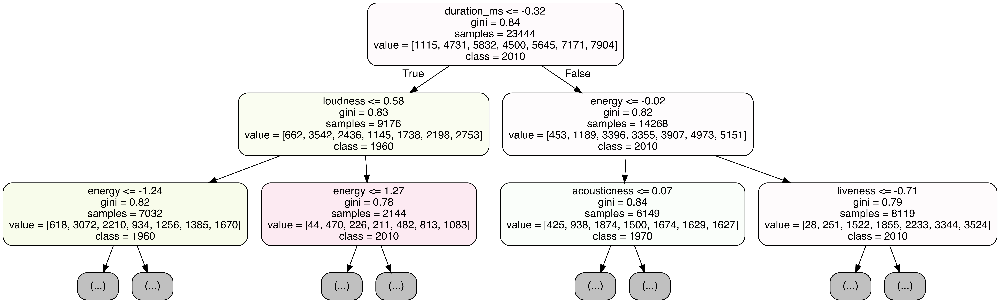

In [211]:
estimator = rfc_gs.best_estimator_.estimators_[18]

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, max_depth=2,
                out_file='tree.dot', 
                feature_names = X_train.columns,
                class_names = y.unique().astype(str),
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

The heavily correlated energy and loudness are front and centre of this decision tree. We can see how important they are to the model's predictive power.

In [212]:
clean[['loudness', 'energy']].corr()

,loudness,energy
loudness,1.00000,0.77925
energy,0.77925,1.00000


## Workarounds

A combination of class imbalance, the number of classes, and similarity of features has been impeding the model so far. However, there are some other inferences we could draw from different approaches to the model, which would solve these issues. Namely, we could:

- Binarize the problem to classify pre-2000 tracks from post-2000
- Restrict the data points to those in the middle of a decade to greater distinguish them

### Binarizing the model

This would solve all three of the above issues, and the model could still be used to describe how music has changed. Let's implement it below:

In [220]:
binarized = clean.copy()
binarized['post2000'] = [1 if x>=2000 else 0 for x in binarized.decade_start]

In [221]:
binarized.post2000.value_counts()

0    27096
1    19027
Name: post2000, dtype: int64

In [223]:
kf = StratifiedKFold(5, True, 10)

predictors = binarized.iloc[:, 10:-3].copy()
y = binarized['post2000']

X_train, X_test, y_train, y_test = train_test_split(predictors, y, stratify=y, test_size=0.2, shuffle=True)

scaler = StandardScaler()
Xs_train = scaler.fit_transform(X_train)
Xs_test = scaler.transform(X_test)

rfc = RandomForestClassifier(n_estimators=300)

params = {
    'min_samples_split':[2, 3, 5],
    'max_depth':[None, 3, 5],
    'n_estimators': [300]
            }
Xs_train = pd.DataFrame(Xs_train, columns=predictors.columns)

rfc_gs = GridSearchCV(rfc, param_grid=params, cv=5, iid=False, verbose=True, n_jobs=-2)    
rfc_gs.fit(Xs_train, y_train)

print('Baseline:', max(y.value_counts(normalize=True)))
print('Train score:', rfc_gs.score(Xs_train, y_train))
print('Test score:', rfc_gs.score(Xs_test, y_test))

Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 11 concurrent workers.
[Parallel(n_jobs=-2)]: Done  45 out of  45 | elapsed:  1.5min finished


Baseline: 0.5874726275394055
Train score: 0.9983738956040978
Test score: 0.7752845528455284


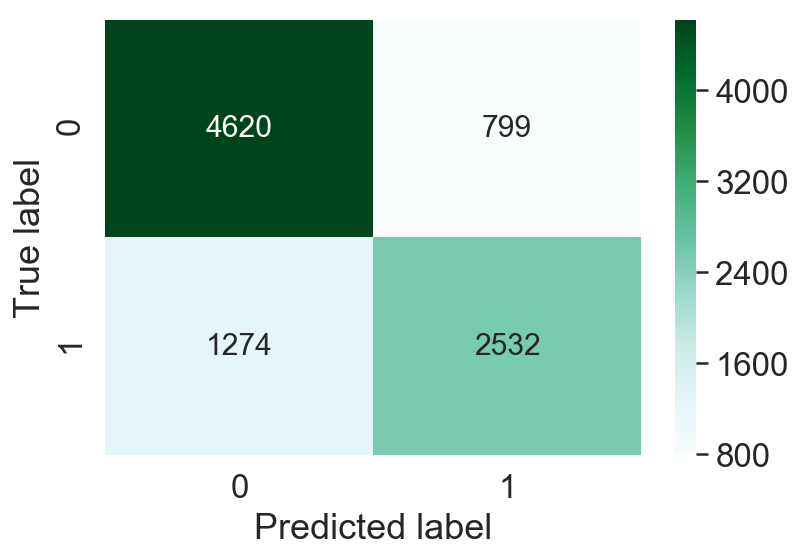

In [227]:
plot_cm(confusion_matrix(y_test, rfc_gs.predict(Xs_test)), [0,1], [6,4])

In [228]:
print(classification_report(y_test, rfc_gs.predict(Xs_test)))

              precision    recall  f1-score   support

           0       0.78      0.85      0.82      5419
           1       0.76      0.67      0.71      3806

   micro avg       0.78      0.78      0.78      9225
   macro avg       0.77      0.76      0.76      9225
weighted avg       0.77      0.78      0.77      9225



In [229]:
fi2 = pd.DataFrame({col: [val] for col, val in zip(predictors.columns, rfc_gs.best_estimator_.feature_importances_)})
fi2

,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,0.098499,0.037991,0.231937,0.008132,0.099191,0.099914,0.075268,0.074743,0.099019,0.076022,0.090551,0.008733


Loudness consolidates its importance here, far outweighing any other feature. This is not altogether surprising, since as shown in the earlier loudness plot, the turn of the millenium is in the middle of its jump up to modern standards. It is therefore easy for the model to work out what was pre- and post-2000 from loudness alone.

### Distinguishing the data

Decades are a fairly arbitrary cutoff for music eras. Disco, for example, started in the late 70s and grew in popularity in the 80s; rock had a very similar sound over those two decades. To account for this, the model might be aided by only taking the middle 7 years of each decade, so that the distinction from the next decade is clearer.

In [232]:
middle = clean[[str(x)[-1]>'2' and str(x)[-1]<'8' for x in clean.release_date.dt.year]].copy()

In [233]:
middle.decade_start.value_counts()

2010    5139
2000    4472
1990    3675
1970    3612
1960    3307
1980    2673
1950     722
Name: decade_start, dtype: int64

In [234]:
len(middle)

23600

In [235]:
kf = StratifiedKFold(5, True, 10)

predictors = middle.iloc[:, 10:-1]
y = predictors.pop('decade_start')

X_train, X_test, y_train, y_test = train_test_split(predictors, y, stratify=y, test_size=0.2, shuffle=True)

scaler = StandardScaler()
Xs_train = scaler.fit_transform(X_train)
Xs_test = scaler.transform(X_test)

rfc = RandomForestClassifier(n_estimators=300)

params = {
    'min_samples_split':[2, 3, 5],
    'max_depth':[None, 3, 5],
    'n_estimators': [300]
            }
Xs_train = pd.DataFrame(Xs_train, columns=predictors.columns)

mid_gs = GridSearchCV(rfc, param_grid=params, cv=5, iid=False, verbose=True, n_jobs=-2)    
mid_gs.fit(Xs_train, y_train)

print('Baseline:', max(y.value_counts(normalize=True)))
print('Train score:', mid_gs.score(Xs_train, y_train))
print('Test score:', mid_gs.score(Xs_test, y_test))

Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 11 concurrent workers.
[Parallel(n_jobs=-2)]: Done  45 out of  45 | elapsed:   54.7s finished


Baseline: 0.2177542372881356
Train score: 0.9995762711864407
Test score: 0.49957627118644066


In [237]:
mid_gs.score(Xs_test, y_test) - best

0.016866244086169657

We can get 28.2% accuracy over the baseline with this model, a further improvement. However, running the model several times gives scores which are sometimes higher, sometimes lower than the original model. There is no significant improvement, with any differences due more to the cross-validation split than anything else.

### Linear regression on loudness

The earlier timeseries analysis seemed to display a linear increase in loudness since the release of Pro Tools in 1984. Let's see if this relationship is strong enough to model.

In [238]:
clean_lr = clean[clean.release_date.dt.year>1983][['release_date', 'loudness']]

In [239]:
clean_lr['diff_in_months'] = (pd.to_datetime(clean_lr.release_date) - pd.to_datetime('1984-01-01'))/np.timedelta64(1, 'M')

In [240]:
predictors = clean_lr.drop(columns='release_date')
y = predictors.pop('diff_in_months')

X_train, X_test, y_train, y_test = train_test_split(predictors, y, test_size=0.2, shuffle=True)

scaler = StandardScaler()
Xs_train = scaler.fit_transform(X_train)
Xs_test = scaler.transform(X_test)

In [241]:
lr = ElasticNet()

params = {
    'alpha' : np.logspace(-8, 0, 20),
    'l1_ratio' : np.linspace(0, 1, 10),
    'fit_intercept' : [True, False]
}

gs_lr = GridSearchCV(lr, verbose=1, param_grid=params, cv=5, n_jobs=-2)

gs_lr.fit(X_train, y_train)

print('Train score:', gs_lr.best_score_)
print('Test score:',gs_lr.score(X_test, y_test))

Fitting 5 folds for each of 400 candidates, totalling 2000 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 11 concurrent workers.
[Parallel(n_jobs=-2)]: Done  46 tasks      | elapsed:    0.2s


Train score: 0.04772808617954003
Test score: 0.05184219042365046


[Parallel(n_jobs=-2)]: Done 2000 out of 2000 | elapsed:    3.0s finished


While there is a relationship between loudness and time, it is not consistent enough to accurately model. A proper time series decomposition would catch the trend better, but on the basis of this score is not worth implementing.

# Conclusions

Over the course of this project we have seen how musical trends, or at least Spotify's analyses of them, are not as tangible as we might think. Music, like fashion, can often be cyclical, and throwbacks to the themes of 20 years before are one of its few constants. This provides a challenge for anyone wishing to model music trends, but nevertheless we have established that:

- We can achieve 28.2% accuracy over the baseline in classifying the decades of songs based on their features. Random forest algorithms handle this problem most effectively.
- We can predict, with 77.5% accuracy (18.8% above baseline), whether a song was released pre- or post-2000.
- Loudness is the defining feature in determining how the sound of music has changed over the epochs. As we initially hypothesized, it all comes down to the master!
- For modern producers, whether you like the new production standards or not, a loud master is now the default for popular tracks, and you may need to stick to it to earn success.

A more complete write-up can be found at the bottom of [this page](https://github.com/sam-lupton/sl-capstone).